Notebook to reproduce plots in the paper

In [1]:
# imports
import os, glob, re
import pandas as pd
import numpy as np
import seaborn as sns

%matplotlib inline
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import scipy
import copy
from scipy import stats
import statsmodels.api as sm
from statsmodels.stats.multitest import multipletests



In [2]:
# general vars

data_dir = '../data/'
outdir = '../outputs_2/'


tenk_features_short_names_dict = {"glasses/contacts_condition (For long-sightedness, i.e. for distance and near, but particularly for near tasks like reading (called 'hypermetropia'))":"hypermetropia",
                                  'occuerd_in_past_two_years (Serious illness, injury or assault to yourself)':'Serious illness, injury or assault (past 2 years)',
                                  'weight_changes_in_the_last_year (Yes - lost weight)':'lost weight in the last year',
                                  'diet_major_changes_5years (Yes, because of illness)' : 'diet_major_changes_5years due to illness',
                                  "experiences_interfering_with_usual_activities (Stomach or abdominal pain)" : "Stomach or abdominal pain",
                                  "experiences_interfering_with_usual_activities (Knee pain)" : "Knee pain",
                                  "experiences_interfering_with_usual_activities (Neck or shoulder pain)" : "Neck or shoulder pain",
                                  "experiences_interfering_with_usual_activities (Back pain)" : "Back pain",
                                  "experiences_interfering_with_usual_activities (Headache)" : "Headache",
                                  "people_living_together_retalated (Son and/or daughter (include step-children))" : "live_together (Child/ren)",
                                  "people_living_together_retalated (Grandparent)" : "live_together (Grandparent)",
                                  "activities_type (Heavy DIY (eg: weeding, lawn mowing, carpentry, digging))" : "activities_type (Heavy DIY)",
                                  "skin_colour_without_tanning (Black)" : "black skin colour",
                                  "falling_asleep_during_daytime (All of the time)" : "daytime sleep (all the time)",
                                  "spread_type (Flora Pro-Active/Benecol)" : "phytosterol spread type",
                                  "tobacco_type_past (None of the above)" : "past tobacco type (other)",
                                  "tobacco_type_past (Hand-rolled cigarettes)" : "past tobacco type (hand-rolled)",
                                  "tobacco_type_past (Manufactured cigarettes)" : "past tobacco type (manufactured)",
                                  "sitting_blood_pressure_systolic" : "systolic bp",
                                  "happiness_level (Extremely unhappy)" : "extremely unhappy",
                                  "friendships_satisfaction (Extremely unhappy)" : "extremely low friendship satisfaction",
                                  "usual_walking_pace (Slow pace)" : "slow walking pace",
                                  "eat_beef (Once or more daily)" : "eat beef daily",
                                  "shortness_of_breath_same_age_group (Yes)" : "shortness of breath for age group",
                                  "shortness_of_breath_same_age_group (No)" : "no shortness of breath for age group",
                                  "tobacco_past_how_often (Smoked on most or all days)" : "past smoking most days",
                                  "doctor_eye_problem_diagnosis (Macular degeneration)" : "macular degeneration",
                                  "bread_type_mainly_eat (White)" : "mainly eat white bread",
                                  "family_relationship_satisfaction (Moderately happy)" : "moderate family satisfaction",
                                  'people_living_together_retalated (Mother and/or father)' : "live_together (Parent/s)",
                                  'family_relationship_satisfaction (Extremely unhappy)' : 'extremely low family satisfaction',
                                  'family_relationship_satisfaction (Very unhappy)' : 'very low family satisfaction',
                                  'family_relationship_satisfaction (Moderately unhappy)' : 'moderately low family satisfaction',
                                  'experiences_interfering_with_usual_activities (Facial pain)' : 'facial pain',
                                  'experiences_interfering_with_usual_activities (Pain all over the body)' : "pain all over the body",
                                  'missingindicator_experiences_interfering_with_usual_activities (Back pain)' : "missing back pain answer",
                                  'missingindicator_wheeze_whistling_in_the_last_year (No)' : "missing no wheezing answer",
                                  'missingindicator_experiences_interfering_with_usual_activities (None of the above)' : "missing no pain answer",
                                  'financial_situation_satisfaction (Very unhappy)' : "very low financial satisfaction",
                                  'financial_situation_satisfaction (Extremely unhappy)' : "extremely low financial satisfaction",
                                  'Serious illness, injury or assault (past 2 years)' : 'serious illness or injury in past 2 years',
                                  'falls_in_the_last_year (More than one fall)' : 'more than one fall in last year',
                                  'attend_activities_once_a_week (Pub or social club)' : 'attend pub or social club once a week',
                                  'doctor_eye_problem_diagnosis (None of the above)' : 'no eye problems diagnosed',
                                  'never_eat (Sugar or foods/drinks containing sugar)' : 'never eat sugary food/drinks',
                                  'visit_friends_family_times (No friends/family outside household)' : 'no friends/family outside household',
                                  "glasses/contacts_condition (For a 'lazy' eye or an eye with poor vision since childhood (called 'amblyopia'))" : 'glasses/contacts for amblyopia',
                                  "glasses/contacts_condition (For a 'squint' or 'turn' in an eye since childhood (called 'strabismus'))" : 'glasses/contacts for strabismus',
                                  'glasses/contacts_condition (Other eye condition)' : 'glasses/contacts for other condition',
                                  'missingindicator_trouble_falling_a_sleep (Never/rarely)' : 'missing no trouble falling asleep answer',
                                  'missingindicator_trouble_falling_a_sleep (Usually)' : 'missing trouble falling asleep answer',
                                  'missingindicator_easy_getting_up (Fairly easy)' : 'missing easy getting up answer',
                                  'missingindicator_easy_getting_up (Not very easy)' : 'missing not easy getting up answer',
                                  'smoke_tobacco_now (Yes, on most or all days)' : 'smoke tobacco now on most days',
                                  'nerves_anxiety_tension_depression_psychiatrist (No)' : 'no anxiety/depression diagnosed by psychiatrist',
                                  'nerves_anxiety_tension_depression_doctor (No)' : 'no anxiety/depression diagnosed by doctor',
                                  'nerves_anxiety_tension_depression_doctor (Yes)' : 'anxiety/depression diagnosed by doctor',
                                 }

tenk_prs_short_names_dict = {"Blood clot, DVT, bronchitis, emphysema, asthma, rhinitis, eczema, allergy diagnosed by doctor: Hayfever, allergic rhinitis or eczema":"Hayfever, allergic rhinitis or eczema",
                             "Blood clot, DVT, bronchitis, emphysema, asthma, rhinitis, eczema, allergy diagnosed by doctor: None of the above":"No clot, dvt, bronchitis, asthma, allergy",
                             "Blood clot, DVT, bronchitis, emphysema, asthma, rhinitis, eczema, allergy diagnosed by doctor: Asthma":"Diagnosed asthma",
                             "Vascular/heart problems diagnosed by doctor: None of the above" : "No heart problems diagnosed by doctor",
                             "Vascular/heart problems diagnosed by doctor: High blood pressure" : "High blood pressure diagnosed by doctor",
                             "Non-cancer illness code, self-reported: hypertension" : "Hypertension - self-reported code",
                             "Non-cancer illness code, self-reported: heart attack/myocardial infarction" : "Heart attack/myocardial infarction - self-reported code",
                             "Non-cancer illness code, self-reported: diabetes" : "Diabetes - self-reported code",
                             "Non-cancer illness code, self-reported: high cholesterol" : "High cholestrerol - self-reported code",
                             "Non-cancer illness code, self-reported: asthma" : "Asthma - self-reported code",
                             'Diagnoses - main ICD10: I25 Chronic ischaemic heart disease' : "Chronic ischaemic heart disease",
                              }

tenk_prs_order = ['Pulse rate, automated reading', 'Non-cancer illness code, self-reported: hypertension',
                    'Non-cancer illness code, self-reported: heart attack/myocardial infarction',
                    'Illnesses of father: Heart disease', 'Illnesses of father: High blood pressure', 'Illnesses of mother: High blood pressure',
                    'Illnesses of siblings: Heart disease', 'Illnesses of siblings: High blood pressure','Chest pain or discomfort',
                    'Age high blood pressure diagnosed', 'Diastolic blood pressure, automated reading', 'Systolic blood pressure, automated reading',
                    'Pulse rate', 'Pulse wave reflection index', 'Vascular/heart problems diagnosed by doctor: Heart attack',
                    'Vascular/heart problems diagnosed by doctor: Angina', 'Vascular/heart problems diagnosed by doctor: High blood pressure',
                    'Major coronary heart disease event', 'Ischaemic heart disease, wide definition',
                    'Diseases of the circulatory system',
                    'Coronary atherosclerosis', 'Non-cancer illness code, self-reported: angina',
                    'Diagnoses - main ICD10: I25 Chronic ischaemic heart disease',
                    'Non-cancer illness code, self-reported: diabetes', 'Non-cancer illness code, self-reported: high cholesterol',
                    'Illnesses of father: Diabetes', 'Illnesses of mother: Diabetes', 'Illnesses of siblings: Diabetes',
                    'Diabetes diagnosed by doctor', 'Diagnoses - main ICD10: G56 Mononeuropathies of upper limb',
                    'Wheeze or whistling in the chest in last year', 'Non-cancer illness code, self-reported: asthma',
                    'Blood clot, DVT, bronchitis, emphysema, asthma, rhinitis, eczema, allergy diagnosed by doctor: Asthma',  
                    'Non-cancer illness code, self-reported: hayfever/allergic rhinitis', 'Doctor diagnosed hayfever or allergic rhinitis',
                    'Blood clot, DVT, bronchitis, emphysema, asthma, rhinitis, eczema, allergy diagnosed by doctor: Hayfever, allergic rhinitis or eczema',
                    'Leg pain on walking','Pain type(s) experienced in last month: Knee pain',
                    'Pain type(s) experienced in last month: Hip pain','Diagnoses - main ICD10: M54 Dorsalgia', 'Fractured/broken bones in last 5 years'
                    'Non-cancer illness code, self-reported: depression', 'Mood swings', 'Miserableness', 'Irritability',
                    'Sensitivity / hurt feelings', 'Fed-up feelings','Nervous feelings', 'Worrier / anxious feelings',
                     "Tense / 'highly strung'", 'Worry too long after embarrassment', "Suffer from 'nerves'", 'Neuroticism score',
                     'Loneliness, isolation', 'Guilty feelings', 'Risk taking', 'Ever felt worried, tense, or anxious for most of a month or longer',
                     'Ever had prolonged loss of interest in normal activities', 'Ever had prolonged feelings of sadness or depression',
                     'General happiness', 'General happiness with own health', 'Belief that own life is meaningful', 'Ever thought that life not worth living',
                     'Felt hated by family member as a child', 'Physically abused by family as a child', 'Felt loved as a child',
                     'Felt very upset when reminded of stressful experience in past month', 'Ever sought or received professional help for mental distress',
                     'Frequency of depressed mood in last 2 weeks', 'Ever suffered mental distress preventing usual activities', 'Ever had period extreme irritability',
                     'Trouble falling or staying asleep, or sleeping too much', 'Recent feelings of tiredness or low energy',
                     'Substances taken for depression: Medication prescribed to you (for at least two weeks)', 'Activities undertaken to treat depression: Talking therapies, such as psychotherapy, counselling, group therapy or CBT',
                     'Frequency of unenthusiasm / disinterest in last 2 weeks', 'Frequency of tenseness / restlessness in last 2 weeks',
                     'Frequency of tiredness / lethargy in last 2 weeks', 'Seen doctor (GP) for nerves, anxiety, tension or depression',
                     'Seen a psychiatrist for nerves, anxiety, tension or depression', 'Happiness', 'Health satisfaction', 'Family relationship satisfaction',
                     'Friendships satisfaction', 'Financial situation satisfaction', 'Ever depressed for a whole week',
                     'Pain type(s) experienced in last month: Headache',
                     'Non-cancer illness code, self-reported: hypothyroidism/myxoedema',
                     'Disorders of gallbladder, biliary tract and pancreas']
tenk_prs_order = [tenk_prs_short_names_dict.get(x,x) for x in tenk_prs_order]



ukb_disease_short_names_dict = {"disorders of lipoprotein metabolism and other lipidaemias" : "lipoprotein disorder or lipidaemia",
                                'Other specified conditions associated with the spine (intervertebral disc displacement)' : 'Spine conditions - intervertebral disc displacement',
                                "stroke, not specified as haemorrhage or infarction" : "stroke, not specified",
                                "osteoporosis with pathological fracture" : "osteoporosis"
                               }


ukb_disease_order = ["essential (primary) hypertension","obesity",
                     "disorders of lipoprotein metabolism and other lipidaemias","atherosclerosis",
                     "aortic aneurysm and dissection","other peripheral vascular diseases",
                     "other diseases of liver","fibrosis and cirrhosis of liver",
                     "other inflammatory liver diseases","non-insulin-dependent diabetes mellitus",
                     "unspecified diabetes mellitus","insulin-dependent diabetes mellitus","hyperthyroidism",
                     "other non-toxic goitre","other hypothyroidism","thyroiditis",
                     "osteoporosis with pathological fracture","nonrheumatic aortic valve disorders",
                     "nonrheumatic mitral valve disorders","atrioventricular and left bundle-branch block",
                     "atrial fibrillation and flutter","cardiomyopathy","chronic ischaemic heart disease",
                     "heart failure","other acute ischaemic heart diseases","acute myocardial infarction",
                     "other chronic obstructive pulmonary disease","other interstitial pulmonary diseases",
                     "pulmonary oedema","pulmonary embolism","asthma","chronic sinusitis",
                     "pneumonia, organism unspecified","migraine","parkinson's disease","alzheimer's disease",
                     "vascular dementia","facial nerve disorders",
                     "stroke, not specified as haemorrhage or infarction","cerebral infarction",
                     "other anxiety disorders","recurrent depressive disorder","ulcerative colitis","dyspepsia",
                     "other rheumatoid arthritis","gout","chronic renal failure",'cholelithiasis',
                     "vitamin d deficiency","acute pancreatitis","cellulitis"]
ukb_disease_order = [ukb_disease_short_names_dict.get(x,x) for x in ukb_disease_order]


prs_groups = ([    ['Pulse rate, automated reading', 'Non-cancer illness code, self-reported: hypertension',
                    'Non-cancer illness code, self-reported: heart attack/myocardial infarction',
                    'Illnesses of father: Heart disease', 'Illnesses of father: High blood pressure', 'Illnesses of mother: High blood pressure',
                    'Illnesses of siblings: Heart disease', 'Illnesses of siblings: High blood pressure','Chest pain or discomfort',
                    'Age high blood pressure diagnosed', 'Diastolic blood pressure, automated reading', 'Systolic blood pressure, automated reading',
                    'Pulse rate', 'Pulse wave reflection index', 'Vascular/heart problems diagnosed by doctor: Heart attack',
                     'Vascular/heart problems diagnosed by doctor: High blood pressure',
                    'Major coronary heart disease event', 'Ischaemic heart disease, wide definition',
                    'Diseases of the circulatory system','Coronary atherosclerosis',
                    'Non-cancer illness code, self-reported: angina', 'Vascular/heart problems diagnosed by doctor: Angina',
                    'Diagnoses - main ICD10: I25 Chronic ischaemic heart disease',],
                   ['Coronary atherosclerosis', 'Non-cancer illness code, self-reported: angina', 'Vascular/heart problems diagnosed by doctor: Angina',
                    'Diagnoses - main ICD10: I25 Chronic ischaemic heart disease','Non-cancer illness code, self-reported: diabetes', 'Non-cancer illness code, self-reported: high cholesterol',
                    'Illnesses of father: Diabetes', 'Illnesses of mother: Diabetes', 'Illnesses of siblings: Diabetes',
                    'Diabetes diagnosed by doctor',],
                   ['Non-cancer illness code, self-reported: diabetes', 'Non-cancer illness code, self-reported: high cholesterol',
                    'Illnesses of father: Diabetes', 'Illnesses of mother: Diabetes', 'Illnesses of siblings: Diabetes',
                    'Diabetes diagnosed by doctor','Diagnoses - main ICD10: G56 Mononeuropathies of upper limb',],
                   ['Wheeze or whistling in the chest in last year', 'Non-cancer illness code, self-reported: asthma',
                    'Blood clot, DVT, bronchitis, emphysema, asthma, rhinitis, eczema, allergy diagnosed by doctor: Asthma',],
                   ['Wheeze or whistling in the chest in last year', 'Non-cancer illness code, self-reported: asthma',
                    'Blood clot, DVT, bronchitis, emphysema, asthma, rhinitis, eczema, allergy diagnosed by doctor: Asthma',  
                    'Non-cancer illness code, self-reported: hayfever/allergic rhinitis', 'Doctor diagnosed hayfever or allergic rhinitis',
                    'Blood clot, DVT, bronchitis, emphysema, asthma, rhinitis, eczema, allergy diagnosed by doctor: Hayfever, allergic rhinitis or eczema',],
                   ['Leg pain on walking',],
                   ['Pain type(s) experienced in last month: Knee pain','Pain type(s) experienced in last month: Hip pain',
                    'Leg pain on walking', 'Diagnoses - main ICD10: M54 Dorsalgia',],
                   ['Pain type(s) experienced in last month: Knee pain','Pain type(s) experienced in last month: Hip pain',
                    'Leg pain on walking', 'Diagnoses - main ICD10: M54 Dorsalgia', 'Fractured/broken bones in last 5 years'],
                   ['Non-cancer illness code, self-reported: depression', 'Mood swings', 'Miserableness', 'Irritability',
                    'Sensitivity / hurt feelings', 'Fed-up feelings','Nervous feelings', 'Worrier / anxious feelings',
                     "Tense / 'highly strung'", 'Worry too long after embarrassment', "Suffer from 'nerves'", 'Neuroticism score',
                     'Loneliness, isolation', 'Guilty feelings', 'Risk taking', 'Ever felt worried, tense, or anxious for most of a month or longer',
                     'Ever had prolonged loss of interest in normal activities', 'Ever had prolonged feelings of sadness or depression',
                     'General happiness', 'General happiness with own health', 'Belief that own life is meaningful', 'Ever thought that life not worth living',
                     'Felt hated by family member as a child', 'Physically abused by family as a child', 'Felt loved as a child',
                     'Felt very upset when reminded of stressful experience in past month', 'Ever sought or received professional help for mental distress',
                     'Frequency of depressed mood in last 2 weeks', 'Ever suffered mental distress preventing usual activities', 'Ever had period extreme irritability',
                     'Trouble falling or staying asleep, or sleeping too much', 'Recent feelings of tiredness or low energy',
                     'Substances taken for depression: Medication prescribed to you (for at least two weeks)', 'Activities undertaken to treat depression: Talking therapies, such as psychotherapy, counselling, group therapy or CBT',
                     'Frequency of unenthusiasm / disinterest in last 2 weeks', 'Frequency of tenseness / restlessness in last 2 weeks',
                     'Frequency of tiredness / lethargy in last 2 weeks', 'Seen doctor (GP) for nerves, anxiety, tension or depression',
                     'Seen a psychiatrist for nerves, anxiety, tension or depression', 'Happiness', 'Health satisfaction', 'Family relationship satisfaction',
                     'Friendships satisfaction', 'Financial situation satisfaction', 'Ever depressed for a whole week',],              
                    ['Pain type(s) experienced in last month: Headache',],
                    ['Non-cancer illness code, self-reported: hypothyroidism/myxoedema',],
                    ['Disorders of gallbladder, biliary tract and pancreas']
              ],
              [    ['essential (primary) hypertension', 'nonrheumatic aortic valve disorders', 'nonrheumatic mitral valve disorders',
                    'atrioventricular and left bundle-branch block', 'atrial fibrillation and flutter', 'cardiomyopathy',
                    'chronic ischaemic heart disease', 'heart failure', 'other acute ischaemic heart diseases', 'acute myocardial infarction',
                    'obesity', 'pulmonary oedema', 'other peripheral vascular diseases',],
                   ['disorders of lipoprotein metabolism and other lipidaemias', 'atherosclerosis',
                    'non-insulin-dependent diabetes mellitus', 'unspecified diabetes mellitus',
                    'insulin-dependent diabetes mellitus', 'obesity', 'chronic renal failure', 'essential (primary) hypertension',],
                   ['non-insulin-dependent diabetes mellitus', 'unspecified diabetes mellitus',
                    'insulin-dependent diabetes mellitus',],
                   ['other chronic obstructive pulmonary disease',],
                   ['asthma','chronic_sinusitis'],
                   ['gout'],
                   ['other rheumatoid arthritis',],
                   ['osteoporosis with pathological fracture'],
                   ['recurrent depressive disorder', 'other anxiety disorders'],              
                   ['migraine',],
                   ['other hypothyroidism',],
                   ['cholelithiasis']
              ])

prs_groups = ([[tenk_prs_short_names_dict.get(x,x) for x in y] for y in prs_groups[0]] , 
              [[ukb_disease_short_names_dict.get(x,x) for x in y] for y in prs_groups[1]])


ukb_shared_diseases = ["essential (primary) hypertension","obesity","lipoprotein disorder or lipidaemia",
                       #"atherosclerosis",
                       "other diseases of liver","fibrosis and cirrhosis of liver",
                       "non-insulin-dependent diabetes mellitus",#"unspecified diabetes mellitus",
                       "other hypothyroidism","osteoporosis with pathological fracture",
                       #"nonrheumatic aortic valve disorders","nonrheumatic mitral valve disorders",
                       "asthma",
                       "chronic sinusitis","migraine","other anxiety disorders",
                       "recurrent depressive disorder","dyspepsia", "cholelithiasis"]

tenk_disease_order = ["Essential hypertension","Obesity","Hyperlipoproteinaemia  ",
                      "Non-alcoholic fatty liver disease","Obstructive sleep apnoea",
                      "Intermediate hyperglycaemia ","Thyrotoxicosis","hypothyroidism",
                      "Low bone mass disorders","Osteoarthritis",'Fracture of unspecified body region',
                      #"Heart valve diseases unspecified",
                      "Asthma","Allergic rhinitis ","Chronic rhinosinusitis",
                      "Migraine","Headache disorders","Anxiety or fear-related disorders",
                      "Depressive disorders","Insomnia disorders","Attention deficit hyperactivity disorder",
                      "Chronic widespread pain","Anal fissure","Haemorrhoids",
                      "Oral aphthae or aphtha-like ulceration","Ulcer of stomach or duodenum",
                      "Irritable bowel syndrome","Helicobacter pylori induced gastritis","Spinal pain",
                      "Other specified conditions associated with the spine (intervertebral disc displacement)",
                      "Polycystic ovary syndrome","Endometriosis","Female infertility",
                      "Hyperplasia of prostate","Urinary tract infection, site and agent not specified",
                      "Urolithiasis","Cholelithiasis","Basal cell carcinoma of skin","Atopic eczema",
                      "Psoriasis","Acne","Cataract","Episodic vestibular syndrome",
                      "Acquired hearing impairment","Anaemias or other erythrocyte disorders",
                      "Iron Deficiency Anemia","Vitamin B12 deficiency"]

tenk_shared_diseases = ["Essential hypertension","Obesity","Hyperlipoproteinaemia  ",
                        "Non-alcoholic fatty liver disease","Intermediate hyperglycaemia ","hypothyroidism",
                        "Low bone mass disorders",#'Fracture of unspecified body region',
                        #"Heart valve diseases unspecified",
                        "Asthma","Chronic rhinosinusitis","Migraine",
                        "Headache disorders","Anxiety or fear-related disorders","Depressive disorders",
                        "Ulcer of stomach or duodenum","Cholelithiasis"]

ukb_disease_to_tenk_condition_dict = {"essential (primary) hypertension" : "Essential hypertension",
                                      "obesity" : "Obesity",
                                      "lipoprotein disorder or lipidaemia" : "Hyperlipoproteinaemia  ",
                                      "other diseases of liver" : "Non-alcoholic fatty liver disease",
                                      "non-insulin-dependent diabetes mellitus" : "Intermediate hyperglycaemia ",
                                      "other hypothyroidism" : "hypothyroidism",
                                      "osteoporosis with pathological fracture" : "Low bone mass disorders",
                                      "asthma" : "Asthma",
                                      "chronic sinusitis" : "Chronic rhinosinusitis",
                                      "migraine" : ["Migraine","Headache disorders"],
                                      "other anxiety disorders" : "Anxiety or fear-related disorders",
                                      "recurrent depressive disorder" : "Depressive disorders",
                                      "dyspepsia" : "Ulcer of stomach or duodenum",
                                      "cholelithiasis" : "Cholelithiasis"
                                     }

tenk_condition_to_ukb_disease_dict = {"Essential hypertension" : "essential (primary) hypertension",
                                      "Obesity" : "obesity",
                                      "Hyperlipoproteinaemia  " : "lipoprotein disorder or lipidaemia",
                                      "Non-alcoholic fatty liver disease" : "other diseases of liver",
                                      "Intermediate hyperglycaemia " : "non-insulin-dependent diabetes mellitus",
                                      "hypothyroidism" : "other hypothyroidism",
                                      "Low bone mass disorders" : "osteoporosis with pathological fracture",
                                      "Asthma" : "asthma",
                                      "Chronic rhinosinusitis" : "chronic sinusitis",
                                      "Migraine" : "migraine",
                                      "Headache disorders" : "migraine",
                                      "Anxiety or fear-related disorders" : "other anxiety disorders",
                                      "Depressive disorders" : "recurrent depressive disorder",
                                      "Ulcer of stomach or duodenum" : 'dyspepsia',
                                      "Cholelithiasis" : "cholelithiasis"
                                     }


drop_outcomes = [130736,132054,132072,132152,131620,131612,131636] # These were not run or are gender specific
##drop_outcomes += [131342] # left bundle branch block - something wrong with the model ??
drop_outcomes += [130702] # thyroiditis - prevalence too low in UKBB


m_conditions = ["Hyperplasia of prostate"]
f_conditions = ['Polycystic ovary syndrome',"Endometriosis","Female infertility"]#,'haemolytic anaemia due to G6PD deficiency']

loaders = ['retina', 'microbiome', 'sleep',  'ECG', 'CGM', 'DEXA', # 'bloodtests', 'bodymeasures', \ 
                'carotid','ABI', 'diet', 'metabolomics','liver','age_gender_bmi'] # , 'diet'

# features that basically overlap with an input feature
drop_features_dict = {'sleep' : ['MeanPRSleep'],
                      'ECG' : ['hr_bpm'],
                      'ABI' : ['l_brachial_pressure', 'r_brachial_pressure'], # 'l_ankle_pressure', 'r_ankle_pressure'
                      'CGM' : ['eA1C'],
                      'DEXA' : ['body_comp_trunk_region_percent_fat', 'body_comp_total_region_percent_fat'],
                      'diet' : [],
                      'CGM_salient' : ['eA1C']
                     }


outcomes_df = pd.read_csv(os.path.join(os.path.dirname(data_dir),'outcomes.csv'))

outcomes_dict = dict(zip(outcomes_df['UKBB Field ID'].values,outcomes_df['UKBB Description'].values))
for o in outcomes_dict:
    outcomes_dict[o] = '('.join(outcomes_dict[o][:-1].split('(')[1:])
for k in drop_outcomes:
    outcomes_dict.pop(k,None)
    
outcomes_inv_dict = {ukb_disease_short_names_dict.get(v,v):k for k,v in outcomes_dict.items()}
    

In [3]:
# Util functions

def load_outcome(outcome):
    pred_dir = os.path.join(data_dir,"predictions")
    predfile = os.path.join(pred_dir,f"{outcome}_predictions.csv")
    assert os.path.isfile(predfile), f'No prediction file for {outcome}'
    preds = pd.read_csv(predfile,index_col=0)
    preds = preds.set_index('RegistrationCode')
    print(f"Loaded predictions for {outcome}")
    return preds


def reorder_cols(df,col_order=None,row_order=None):
    if col_order is not None:
        common_columns =[x for x in col_order if x in df.columns]
        df = df.reindex(columns=common_columns)
    if row_order is not None:
        common_rows = [x for x in row_order if x in df.index]
        df = df.reindex(index = common_rows)
    return df 



def fdr_correct_nested(loader_dict, alpha=0.05, method='fdr_bh'):

    pvals_all = []
    positions = []  # (loader, sex_df, row_idx, col_idx)

    for loader in loader_dict:
        for sex in ['m_pvals', 'f_pvals']:
            df = loader_dict[loader][sex]
            for i in range(df.shape[0]):
                for j in range(df.shape[1]):
                    pvals_all.append(df.iat[i, j])
                    positions.append((loader, sex, i, j))

    pvals_all = np.array(pvals_all, dtype=float)
    pvals_final = np.array(pvals_all, dtype=float)
    reject_final = np.array([False] * len(pvals_all), dtype=bool)
    notna_mask = ~np.isnan(pvals_all)
    pvals_all = pvals_all[notna_mask]
    
    # replace nans with 1
    # pvals_all[np.isnan(pvals_all)] = 1.0


    reject, pvals_corr, _, _ = multipletests(pvals_all, alpha=alpha, method=method)


    pvals_final[notna_mask] = pvals_corr
    reject_final[notna_mask] = reject
    
    print(pvals_all.shape, pvals_corr.shape, pvals_final.shape)
    tot = 0
    for loader in loader_dict:
        for sex in ['m_pvals', 'f_pvals']:
            df = loader_dict[loader][sex]
            print(loader, sex, df.shape)
            tot += df.shape[0]*df.shape[1]
            loader_dict[loader][f"{sex}_fdr"] = pd.DataFrame(
                np.nan, index=df.index, columns=df.columns
            )
            loader_dict[loader][f"{sex}_reject_fdr"] = pd.DataFrame(
                False, index=loader_dict[loader][f"{sex}"].index,
                columns=loader_dict[loader][f"{sex}"].columns
            )
    print(f"TOTAL {tot}")
    for (loader, sex, i, j), p_corr, rej in zip(positions, pvals_final, reject_final):
        loader_dict[loader][f"{sex}_fdr"].iat[i, j] = p_corr
        loader_dict[loader][f"{sex}_reject_fdr"].iat[i, j] = rej
        
        
    print("Generated corrected p-values")

    return loader_dict




#### Figure 1b plot pseudo-outcome model feature coefficients vs diseases in heatmap

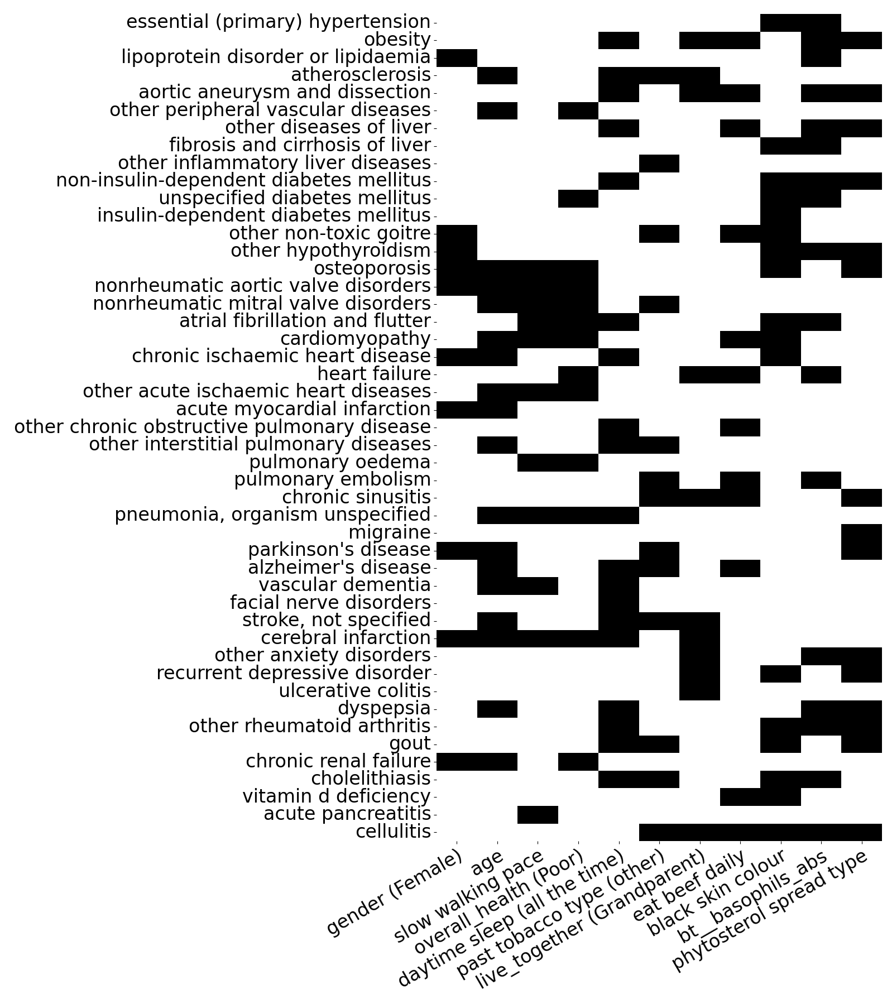

In [138]:
feature_files = glob.glob(os.path.join(data_dir,'model_summaries','*_model_summary.csv'))
features_dict = {}
for f in feature_files:
    df = pd.read_csv(f)
    df = df.loc[df['coef'].abs().nlargest(10).index]
    outcome = os.path.basename(f).split('_')[0]
    features_list =  df['covariate'].unique()
    features_dict[outcomes_dict[int(outcome)]] = {f:1 for f in features_list}

features_df = pd.DataFrame.from_dict(features_dict, orient='index').fillna(0).astype(int)

col_sums = features_df.sum(axis=0)
drop_cols = features_df.columns[col_sums<10] # < 1] # uncomment for supp fig

features_dropped = features_df.drop(columns=drop_cols)

row_sums = features_dropped.sum(axis=1)
drop_rows = features_dropped.index[row_sums<1]

features_dropped = features_dropped.drop(index=drop_rows)
features_dropped = features_dropped.drop(columns = features_dropped.columns[features_dropped.sum(axis=0) < 1])

features_dropped = features_dropped.rename(columns=tenk_features_short_names_dict, index=ukb_disease_short_names_dict)
features_dropped = features_dropped.reindex(index=\
                                            [r for r in ukb_disease_order if r in features_dropped.index])


g = sns.clustermap(features_dropped,cmap='binary',dendrogram_ratio=(0.0,0.0),colors_ratio=0.01, col_cluster=True, row_cluster=False, cbar_pos=None,metric='hamming',figsize=(16,18)) # 22,12)) # uncomment for supp #,col_cluster=False)#,cbar_kws = {'ticks':[0,1],'orientation':'horizontal'})
g.ax_heatmap.yaxis.tick_left()
g.ax_heatmap.set_xticklabels(g.ax_heatmap.get_xticklabels(),fontsize=24, rotation=30, rotation_mode='anchor', ha='right')
g.ax_heatmap.set_yticklabels(g.ax_heatmap.get_yticklabels(),fontsize=24)


plt.tight_layout()
plt.savefig(os.path.join(outdir,'outcome_clusters.png'),dpi=300) # _supp.png'))
                                       

#### Figure 1c Box plots of predicted time to event on HPP for all diseases

Loaded predictions for 131286
Loaded predictions for 131298
Loaded predictions for 131306
Loaded predictions for 130714
Loaded predictions for 131494
Loaded predictions for 131670
Loaded predictions for 131668
Loaded predictions for 131666
Loaded predictions for 130792
Loaded predictions for 130706
Loaded predictions for 130708
Loaded predictions for 131304
Loaded predictions for 131324
Loaded predictions for 131322
Loaded predictions for 131338
Loaded predictions for 131354
Loaded predictions for 131350
Loaded predictions for 131380
Loaded predictions for 131382
Loaded predictions for 131468
Loaded predictions for 131492
Loaded predictions for 131524
Loaded predictions for 131456
Loaded predictions for 131022
Loaded predictions for 131036
Loaded predictions for 131064
Loaded predictions for 131366
Loaded predictions for 131052
Loaded predictions for 130838
Loaded predictions for 130906
Loaded predictions for 130896
Loaded predictions for 131850
Loaded predictions for 131858
Loaded pre

/var/folders/vt/cymwjpv54g93bqgwvmlr0bfm0000gq/T/ipykernel_27399/110310810.py:47: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='Time to event', y='Outcome', data=df_melted, palette = color_mapping,#sns.color_palette("husl", len(ordered_cols), desat=0.8),


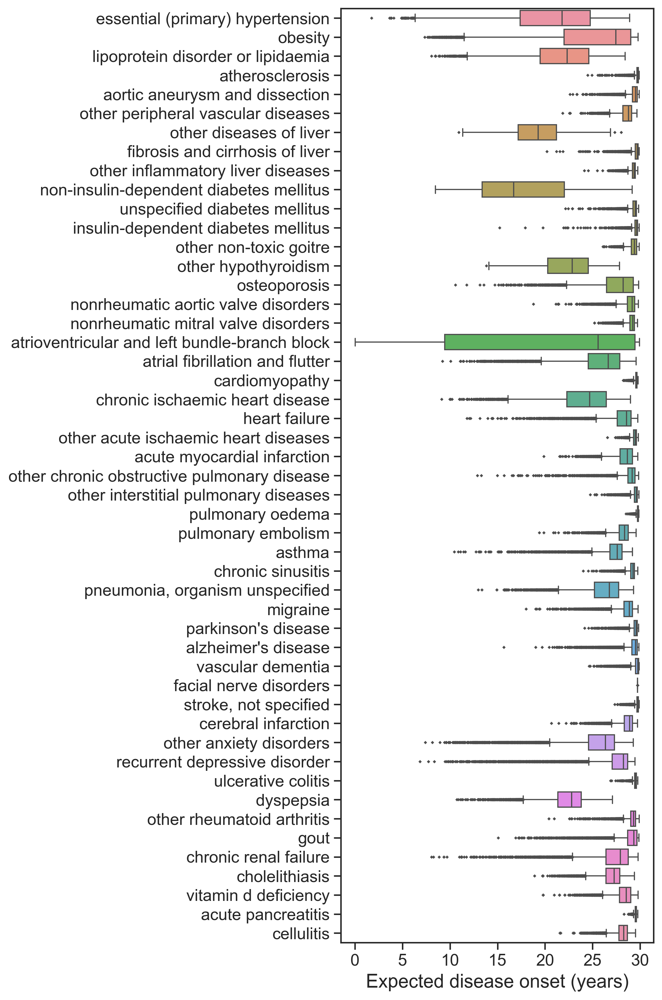

In [29]:
# plot figure 1c
def plot_pseudo_outcomes():
    preds = {}
    for o in outcomes_dict:
        pred = load_outcome(o) / 365.
        pred.columns = [outcomes_dict[o]]
        preds[o] = pred
    df = pd.concat(preds.values(),axis=1)
    df = df.rename(columns=ukb_disease_short_names_dict)
    print(df.info())
    df_melted = df.melt(var_name="Outcome",value_name="Time to event")
    ordered_cols = [x for x in ukb_disease_order if x in df.columns]
    
    import matplotlib.colors as mcolors
    def pastelized_husl(n):
        """Return a pastel version of husl colors by blending with white."""
        base_colors = sns.color_palette("husl", n)
        pastel_colors = [mcolors.to_rgba(c, alpha=1.0) for c in base_colors]
        # Blend each color with white to create a pastel tone
        pastel_blend = [(0.85 * r + 0.15, 0.85 * g + 0.15, 0.85 * b + 0.15) for r, g, b, _ in pastel_colors]
        return pastel_blend
    palette = pastelized_husl(len(ordered_cols))
    color_mapping = dict(zip(ordered_cols, palette))
    
    plt.figure(figsize=(17, 9),dpi=300)
    sns.set_theme(style="ticks")
    sns.boxplot(x='Outcome', y='Time to event', data=df_melted, palette = color_mapping,#sns.color_palette("husl", len(ordered_cols), desat=0.8),
                order=ordered_cols,flierprops={
                                        'marker': 'D',
                                        # 'color': 'gray',
                                        # 'alpha': 0.5,
                                        'markerfacecolor': 'gray',
                                        # 'markeredgecolor': 'gray',
                                        'markersize': 2
                                    })
    plt.xticks(rotation=45,ha='right',fontsize=14)
    # plt.grid(False)
    # ax = plt.gca()
    # for spine in ax.spines.values():
    #     spine.set_color("black")
    plt.yticks(fontsize=14)
    plt.xlabel('')
    plt.ylabel('Expected disease onset (years)', fontsize=16)
    plt.tight_layout()
    plt.savefig(os.path.join(outdir,'pseudo_outcome_distributions'))
    
plot_pseudo_outcomes()

'0.13.2'

#### Generate heatmaps of pseudo-outcome - feature correlations (S2-S12)

In [6]:
# Heatmap plot helper functions

def split_corr_genders(loader_dict,loader,loader_corrs, gender="m"):
    pvals = loader_corrs.loc[:,(slice(None),f'{gender}_pval')]
    pvals.columns = pvals.columns.droplevel(1)
    pvals = pvals.rename(columns=ukb_disease_short_names_dict)
    loader_dict[loader][f'{gender}_pvals'] = pvals
    
    corrs = loader_corrs.loc[:,(slice(None),f'{gender}_r')]
    corrs.columns = corrs.columns.droplevel(1)
    corrs = corrs.rename(columns=ukb_disease_short_names_dict)
    loader_dict[loader][f'{gender}_corrs'] = corrs
    return loader_dict


def load_corrs_dict_gendered(files_list):
    loader_dict = {}
    for corr_file in files_list:
        loader = os.path.splitext(os.path.basename(corr_file))[0]
        loader_dict[loader] = {}
        loader_corrs = pd.read_csv(corr_file,header=[0,1],index_col=0)
        print(len(loader_corrs))
        if loader in drop_features_dict:
            loader_corrs = loader_corrs.drop(drop_features_dict[loader])
            print(len(loader_corrs))
            
        top_level_values = loader_corrs.columns.get_level_values(0).unique()
        for top_level in top_level_values:
            if ukb_disease_short_names_dict.get(top_level,top_level) not in outcomes_inv_dict:
                loader_corrs = loader_corrs.drop(columns=loader_corrs.columns[loader_corrs.columns.get_level_values(0) == top_level])
                
        loader_dict = split_corr_genders(loader_dict,loader,loader_corrs,'m')
        loader_dict = split_corr_genders(loader_dict,loader,loader_corrs,'f')
    
    return loader_dict

def drop_loader_nonsig_genders(loader_dict,loader,tot_size,gender="m"):
    loader_dict[loader][f'{gender}_pvals'] = loader_dict[loader][f'{gender}_pvals']*tot_size
    loader_dict[loader][f'{gender}_pvals'][loader_dict[loader][f'{gender}_pvals']>0.05] = np.nan
    loader_dict[loader][f'{gender}_pvals'].dropna(axis=0, how='all', inplace=True)
    loader_dict[loader][f'{gender}_pvals'].dropna(axis=1, how='all', inplace=True)
    # loader_dict[loader][f'{gender}_pvals'].to_csv(os.path.join(outdir,f'{loader}_{gender}_corrected_pvals_manual.csv'))
    
    loader_dict[loader][f'{gender}_corrs'] = loader_dict[loader][f'{gender}_corrs'].loc[loader_dict[loader][f'{gender}_pvals'].index,
                                                                        loader_dict[loader][f'{gender}_pvals'].columns]                   
    return loader_dict    

def drop_loader_nonsig_bh_genders(loader_dict,loader,gender="m"):
    loader_dict[loader][f'{gender}_pvals_fdr'][loader_dict[loader][f'{gender}_pvals_reject_fdr']==False] = np.nan
    loader_dict[loader][f'{gender}_pvals_fdr'].dropna(axis=0, how='all', inplace=True)
    loader_dict[loader][f'{gender}_pvals_fdr'].dropna(axis=1, how='all', inplace=True)
    # loader_dict[loader][f'{gender}_pvals_reject_fdr'].to_csv(os.path.join(outdir,f'{loader}_{gender}_reject_bonf.csv'))
    loader_dict[loader][f'{gender}_pvals_fdr'].to_csv(os.path.join(outdir,f'{loader}_{gender}_corrected_pvals_bonf.csv'))
    loader_dict[loader][f'{gender}_corrs'] = loader_dict[loader][f'{gender}_corrs'].loc[loader_dict[loader][f'{gender}_pvals_fdr'].index,
                                                                        loader_dict[loader][f'{gender}_pvals_fdr'].columns]                   
    return loader_dict  



def drop_nonsig_gendered(loader_dict):
    tot_size = sum([(loader_dict[loader]['m_pvals'].notnull().sum().sum().sum() + loader_dict[loader]['f_pvals'].notnull().sum().sum().sum()) \
                        for loader in loader_dict.keys()])
    
def nan_out_nonsig_gendered(loader_dict):
    tot_size = sum([(loader_dict[loader]['m_pvals'].notnull().sum() + loader_dict[loader]['f_pvals'].notnull().sum()) \
                        for loader in loader_dict.keys()])  
    for loader in loader_dict.keys():
        loader_dict[loader][f'm_pvals'] = loader_dict[loader][f'm_pvals']*tot_size
        loader_dict[loader][f'm_pvals'][loader_dict[loader][f'm_pvals']>0.05] = np.nan
        loader_dict[loader][f'f_pvals'] = loader_dict[loader][f'f_pvals']*tot_size
        loader_dict[loader][f'f_pvals'][loader_dict[loader][f'f_pvals']>0.05] = np.nan
    return loader_dict 
    
    
    # tot_size = np.float64(tot_size)
    print(tot_size)
    for loader in loader_dict.keys():
        loader_dict = drop_loader_nonsig_genders(loader_dict,loader,tot_size,gender="m")
        loader_dict = drop_loader_nonsig_genders(loader_dict,loader,tot_size,gender="f")
        
    return loader_dict                   

def plot_corrs_pvals_genders(corrs,pvals,loader,gender, loader_lens=None, borders = None):
    
        fname_prefix = loader
        
        fname_prefix += "_"+gender
        
        mask = pvals.isna()
        cmap=sns.color_palette('RdBu_r',n_colors=256)
        fig, ax = plt.subplots(figsize=(16, 16))
        sns.heatmap(pvals,cmap=cmap,mask=mask)#,dendrogram_ratio=(0.0,0.0))
        plt.title(loader)
        plt.xticks(fontsize=14)
        plt.yticks(fontsize=14)
        plt.tight_layout() 
        plt.savefig(os.path.join(outdir,f'{fname_prefix}_sig_pvals_partial_corrs_full_correction.pdf'))

        plt.clf()
        ## small # fig, ax = plt.subplots(figsize=(10, 10),dpi=600)
        ## large # fig, ax = plt.subplots(figsize=(20, 25),dpi=600)
        # fig, ax = plt.subplots(figsize=(20, 16),dpi=600)
        fig, ax = plt.subplots(figsize=(20, 26),dpi=600)
        heatmap = sns.heatmap(corrs,cmap=cmap,center=0,mask=mask,cbar_kws={"shrink":0.5},vmin=-.4,vmax=.4)##,dendrogram_ratio=(0.0,0.0))
        colorbar = heatmap.collections[0].colorbar
        colorbar.ax.tick_params(labelsize=14) 
        
        if loader_lens is not None:
            colors = sns.color_palette(n_colors=len(loader_lens))
            start = 0
            for i,l in enumerate(loader_lens):
                for j in range(l[1]):
                    ax.annotate('                                        ', xy=(0, start+j), xytext=(-ax.yaxis.labelpad, 0),
                                xycoords=('axes fraction', 'data'), textcoords='offset points',
                                ha='right', va='top', fontsize=22.5,
                                bbox=dict(fc=colors[i],  boxstyle='square,pad=0', ec='none',alpha=0.1))
                start += l[1]
                
#             legend_patches = [patches.Patch(color=color, label=label.split('_')[0], alpha=0.1) for label, color in zip([l[0] for l in loader_lens], colors)]
#             plt.legend(handles=legend_patches, bbox_to_anchor=(1.15, 1.01), fontsize=16, title="Modality")
        
        
        if borders is not None:
            rows = borders[0]
            cols = borders[1]
            prev = ((0,0),(0,0))
            for i in range(len(rows)):
                row_inds = [corrs.index.get_loc(r) for r in rows[i] if r in corrs.index]
                col_inds = [corrs.columns.get_loc(c) for c in cols[i] if c in corrs.columns]
                
                if len(row_inds)>0 and len(col_inds)>0:
                
                    row_inds.sort()
                    col_inds.sort()

                    min_col = col_inds[0]
                    max_col = col_inds[-1]+1
                    min_row = row_inds[0]
                    max_row = row_inds[-1]+1
                    skip =  (min_row >= prev[0][0] and max_row <= prev[0][1] \
                       and min_col >= prev[1][0] and max_col <= prev[1][1])
                    prev = ((min_row,max_row),(min_col,max_col))
                    if skip: continue
                    
                
                    print(row_inds)
                    print(col_inds)
                    ax.add_patch(plt.Rectangle((min_col, min_row), max_col-min_col, max_row-min_row, 
                            fill=False, edgecolor='grey', linewidth=1))
                    #ax.axhspan(row_inds[0], row_inds[-1]+1, col_inds[0], col_inds[-1]+1, facecolor='none', edgecolor='black', linewidth=3)
                   # ax.axvspan(col_inds[0], col_inds[-1]+1, facecolor='none', edgecolor='black', linewidth=3)
                    xlim = ax.get_xlim()
                    ylim = ax.get_ylim()

                    # Update the upper limits with a slight margin
                    margin = 0.1
                    ax.set_xlim(xlim[0], xlim[1] + margin)
                    ax.set_ylim(ylim[0]+margin, ylim[1])
        
        plt.title(gender,fontsize=22)#loader+ " - " + gender)
        plt.xticks(fontsize=18,rotation=45,ha='right')
        plt.yticks(fontsize=18)
        plt.tight_layout()
        plt.savefig(os.path.join(outdir,f'{fname_prefix}_sig_corrs_partial_corrs_full_correction_bonf.png'))   
        
       

In [15]:
# plot heatmaps

files_list = glob.glob(os.path.join(data_dir,'corrs','*.csv'))
files_list = [f for f in files_list if '_salient' not in f] # remove salient feature files

loader_dict = load_corrs_dict_gendered(files_list)
print(loader_dict.keys())
loader_dict = {k:v for k,v in loader_dict.items() if k in loaders} # !!!
print(loader_dict.keys())

print(sum([len(loader_dict[l]['m_corrs']) for l in loader_dict]))
# loader_dict = drop_nonsig_gendered(loader_dict)

loader_dict = fdr_correct_nested(loader_dict, alpha=0.05, method='bonferroni')
loader_dict = drop_nonsig_gendered_bh(loader_dict)


for loader in []:#['microbiome','metabolomics','DEXA']:#loader_dict:
    print(loader)
    for df in loader_dict[loader]:
        loader_dict[loader][df] = reorder_cols(loader_dict[loader][df],col_order = ukb_disease_order)
    plot_corrs_pvals_genders(loader_dict[loader]['m_corrs'],loader_dict[loader]['m_pvals_fdr'],loader,"Male")
    plot_corrs_pvals_genders(loader_dict[loader]['f_corrs'],loader_dict[loader]['f_pvals_fdr'],loader,"Female")

3692
153
153
436
434
6
518
18
16
99
112
111
48
72
71
48
47
88
dict_keys(['metabolomics', 'diet', 'DEXA', 'carotid', 'microbiome', 'ABI', 'liver', 'ECG', 'retina', 'sleep', 'CGM', 'prs'])
dict_keys(['metabolomics', 'diet', 'DEXA', 'carotid', 'microbiome', 'ABI', 'liver', 'ECG', 'retina', 'sleep', 'CGM'])
5195
(514650,) (514650,) (519500,)
Generated corrected p-values


#### Fig 3a salient feature correlations

In [225]:
# helper functions

def stack_loaders_dict(loader_dict):
    stacked_m_pvals = pd.concat([loader_dict[loader]['m_pvals_fdr'] for loader in loader_dict])
    stacked_f_pvals = pd.concat([loader_dict[loader]['f_pvals_fdr'] for loader in loader_dict])
    stacked_m_corrs = pd.concat([loader_dict[loader]['m_corrs'] for loader in loader_dict])
    stacked_f_corrs = pd.concat([loader_dict[loader]['f_corrs'] for loader in loader_dict])
    stacked_dict = {"all": {'m_pvals_fdr' : stacked_m_pvals, 'f_pvals_fdr' : stacked_f_pvals,
                            'm_corrs' : stacked_m_corrs, 'f_corrs' : stacked_f_corrs}}
    return stacked_dict


def get_loader_lens(loader_dict):
    m_loader_lens = [(loader,len(loader_dict[loader]['m_pvals_fdr'])) for loader in loader_dict]
    f_loader_lens = [(loader,len(loader_dict[loader]['f_pvals_fdr'])) for loader in loader_dict]
    return m_loader_lens, f_loader_lens

def plot_main_features_heatmap(stacked_dict,m_loader_lens,f_loader_lens):
    m_corrs = reorder_cols(stacked_dict["all"]['m_corrs'],col_order = ukb_disease_order)
    m_pvals = reorder_cols(stacked_dict["all"]['m_pvals_fdr'],col_order = ukb_disease_order)
    f_corrs = reorder_cols(stacked_dict["all"]['f_corrs'],col_order = ukb_disease_order)
    f_pvals = reorder_cols(stacked_dict["all"]['f_pvals_fdr'],col_order = ukb_disease_order)
    if m_corrs.size>0:
        plot_corrs_pvals_genders(m_corrs,m_pvals,"Male",'Male',m_loader_lens)
    if f_corrs.size>0:
        plot_corrs_pvals_genders(f_corrs,f_pvals,"Female",'Female',f_loader_lens)


In [240]:
files_list = glob.glob(os.path.join(data_dir,'corrs','*_salient.csv'))
loader_dict = load_corrs_dict_gendered(files_list)
# loader_dict = drop_nonsig_gendered(loader_dict)
loader_dict = fdr_correct_nested(loader_dict, alpha=0.05, method='bonferroni')
loader_dict = drop_nonsig_gendered_bh(loader_dict)  
print(loader_dict.keys())
stacked_dict = stack_loaders_dict(loader_dict)
m_loader_lens, f_loader_lens = get_loader_lens(loader_dict)

plot_main_features_heatmap(stacked_dict,m_loader_lens,f_loader_lens)

8
7
5
1
4
2
8
8
8
8
4
(5500,) (5500,) (5500,)
dict_keys(['CGM_salient', 'ECG_salient', 'carotid_salient', 'liver_salient', 'ABI_salient', 'microbiome_phyla_salient', 'retina_salient', 'DEXA_salient', 'diet_salient', 'sleep_salient'])


<Figure size 1600x1600 with 0 Axes>

<Figure size 1600x1600 with 0 Axes>

#### Fig 3b common diseases histogram

In [308]:
# fig 3b functions
def get_nonnull_gender(loader_dict,gender):
    df_list = [loader_dict[k][f'{gender}_pvals_fdr'].rename(lambda x: f'{k}_{x}') for k in loader_dict]
    all_df = pd.concat(df_list)
    nonnull = all_df.notnull().sum(axis=1)
    return nonnull    
      
    
# def plot_disease_hist_two_panel(m_nonnull,f_nonnull,bins):
    
#     plt.clf()
#     fig, ax = plt.subplots(figsize=(16, 8),dpi=300)
#     m_nonnull=m_nonnull.rename('Male')
#     f_nonnull=f_nonnull.rename('Female')
#     merged = pd.concat([m_nonnull,f_nonnull],axis=1).T
#     merged.index.rename('gender',inplace=True)
#     merged = merged.reset_index()
#     melted = pd.melt(merged, id_vars=['gender'], var_name = "features", value_name='num_diseases')
#     g = sns.FacetGrid(melted, col='gender', aspect=1.5, height=5, sharey=True)
#     g.map_dataframe(sns.histplot, bins=bins)#,binwidth=1)
#     # Set axis labels and titles
#     g.set_axis_labels("Number significantly correlated diseases", "Number features",fontsize=18)
#     g.set_titles(col_template="{col_name}",size=18)
#     # Adjust the layout
#     #plt.subplots_adjust(top=0.9)  # Adjust the top of the subplots to make room for the titles
#    # plt.xticks(fontsize=16)
#     for ax in g.axes.flat:
#         ax.yaxis.set_tick_params(labelsize=16)
#         ax.xaxis.set_tick_params(labelsize=16)
#     plt.tight_layout()
#     plt.savefig(os.path.join(outdir,'num_correlated_males_females.png'))

def plot_disease_hist_two_panel(m_nonnull, f_nonnull, bin_edges, xticks):
    plt.clf()
    fig, axes = plt.subplots(nrows=2, ncols=1, figsize=(10, 14), dpi=600, sharex=True)

    # Top: Male
    PASTEL_BLUE = "#5B9BD5"
    sns.histplot(x=m_nonnull.values, bins=bin_edges, ax=axes[0],
                 edgecolor="black", linewidth=0.8, color=PASTEL_BLUE)
    axes[0].set_title("Male", fontsize=24)
    axes[0].set_xlabel("")
    axes[0].set_ylabel("")
    axes[0].tick_params(axis='both', labelsize=14)
    sns.despine(ax=axes[0], top=True, right=True)

    # Bottom: Female
    sns.histplot(x=f_nonnull.values, bins=bin_edges, ax=axes[1],
                 edgecolor="black", linewidth=0.8, color=PASTEL_BLUE)
    axes[1].set_title("Female", fontsize=24)
    axes[1].set_xlabel("")
    axes[1].set_ylabel("")
    axes[1].tick_params(axis='both', labelsize=18)
    sns.despine(ax=axes[1], top=True, right=True)

    # Make sure ticks align with bin centers
    for ax in axes:
        ax.set_xticks(xticks)
    axes[1].set_xlim(bin_edges[0], bin_edges[-1])

    # Shared labels
    fig.text(0.54, 0.04, 'Number significantly correlated diseases', ha='center', fontsize=30)
    fig.text(0.04, 0.5, 'Number features', va='center', rotation='vertical', fontsize=30)

    plt.tight_layout(rect=[0.06, 0.06, 1, 1])
    plt.savefig(os.path.join(outdir, 'num_correlated_males_females_bonf.png'))
 


    
def print_num_common_gendered(nonnull,num_common=25,gender="m"):
    common = nonnull[nonnull>num_common]
    print(len(common))
    print(f'Features correlated to > {num_common} diseases, {gender}:')
    print("\n".join(common.index.tolist()))    

def plot_num_diseases_hist(loader_dict):
    
    m_nonnull = get_nonnull_gender(loader_dict,gender='m')
    f_nonnull = get_nonnull_gender(loader_dict,gender='f')
    xmin = int(np.floor(min(m_nonnull.min(), f_nonnull.min())))
    xmax = int(np.ceil(max(m_nonnull.max(), f_nonnull.max())))

    # One bin per integer: centers at integers, edges at half-integers
    bin_edges = np.arange(0 - 0.5, xmax + 2, 1)
    xticks = np.arange(0, xmax + 1, 5)

    print_num_common_gendered(m_nonnull, num_common=25, gender="m")
    print_num_common_gendered(f_nonnull, num_common=25, gender="f")

    plot_disease_hist_two_panel(m_nonnull, f_nonnull, bin_edges, xticks)
#     bins = max(max(m_nonnull),max(f_nonnull))-min(min(m_nonnull),min(f_nonnull))+1
    
#     print_num_common_gendered(m_nonnull,num_common=25,gender="m")
#     print_num_common_gendered(f_nonnull,num_common=25,gender="f")
   
# #     plot_disease_hist_gender(m_nonnull,bins,"Male")
# #     plot_disease_hist_gender(f_nonnull,bins,"Female")
#     # plot as one fig
#     plot_disease_hist_two_panel(m_nonnull,f_nonnull,bins)
    

3692
153
153
436
434
6
518
18
16
99
112
111
48
72
71
48
47
88
(514650,) (514650,) (519500,)
([('metabolomics', 1224), ('diet', 119), ('DEXA', 381), ('carotid', 2), ('microbiome', 111), ('ABI', 8), ('liver', 5), ('ECG', 34), ('retina', 14), ('sleep', 35), ('CGM', 38)], [('metabolomics', 1284), ('diet', 96), ('DEXA', 381), ('carotid', 1), ('microbiome', 94), ('ABI', 8), ('liver', 8), ('ECG', 31), ('retina', 16), ('sleep', 31), ('CGM', 37)])
57
Features correlated to > 25 diseases, m:
metabolomics_Lipids_POS_538.3862_227.4236_250.8507
DEXA_body_comp_trunk_right_region_percent_fat
DEXA_body_arm_right_bmc
DEXA_body_arms_bmc
DEXA_body_legs_bmc
DEXA_body_comp_total_left_region_percent_fat
DEXA_body_comp_android_region_percent_fat
DEXA_body_comp_arm_right_bone_mass
DEXA_body_comp_trunk_fat_mass
DEXA_body_comp_leg_left_bone_mass
DEXA_body_comp_legs_lean_mass
DEXA_body_comp_total_fat_free_mass
DEXA_body_comp_legs_bone_mass
DEXA_body_comp_leg_right_bone_mass
DEXA_body_comp_leg_right_lean_mass
DEX

<Figure size 640x480 with 0 Axes>

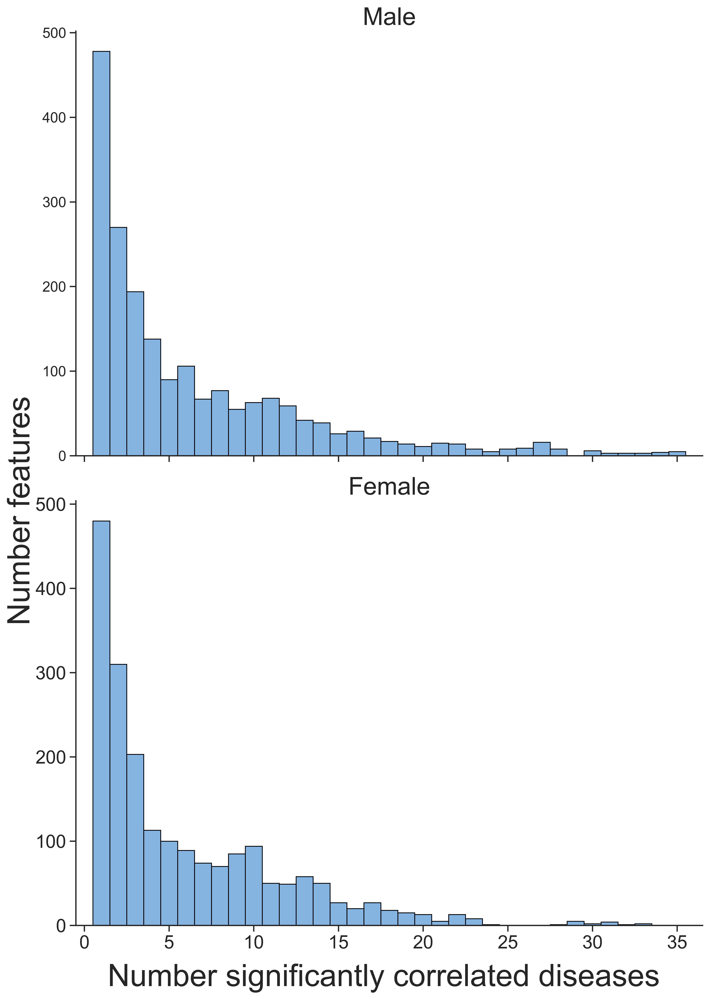

In [309]:
# plot
files_list = glob.glob(os.path.join(data_dir,'corrs','*.csv'))
files_list = [f for f in files_list if '_salient' not in f] # remove salient feature files
loader_dict = load_corrs_dict_gendered(files_list)

loader_dict = {k:v for k,v in loader_dict.items() if k in loaders}
loader_dict = fdr_correct_nested(loader_dict, alpha=0.05, method='bonferroni')

loader_dict = drop_nonsig_gendered_bh(loader_dict)  

print(get_loader_lens(loader_dict))
plot_num_diseases_hist(loader_dict)

Get individual corrs or p-values


In [36]:
files_list = glob.glob(os.path.join(data_dir,'corrs','*.csv'))
files_list = [f for f in files_list if '_salient' not in f] # remove salient feature files

loader_dict = load_corrs_dict_gendered(files_list)
loader_dict = {k:v for k,v in loader_dict.items() if k in loaders} # !!!

loader_dict = drop_nonsig_gendered(loader_dict)

loader_dict['microbiome']['m_pvals'].loc['QAKL01 sp003343815_Rep_2056','cholelithiasis']


3692
153
153
436
434
6
518
18
16
99
112
111
48
72
71
48
47
88
524943


9.291491099999999e-11

#### Figure 2c correlations between PRSes and pseudo-outcomes

In [182]:
# Functions

def rename_reorder_prs(loader_dict):
    for loader in loader_dict:
        for df in loader_dict[loader]:
            loader_dict[loader][df] = loader_dict[loader][df].rename(index=tenk_prs_short_names_dict)
            loader_dict[loader][df] = reorder_cols(loader_dict[loader][df],col_order = ukb_disease_order, row_order = tenk_prs_order)
    return loader_dict



88
(960,) (960,) (4928,)
[0, 1, 2, 3]
[0]
[4, 5]
[0, 1]
[6, 7]
[2]
[8, 9, 10, 11, 12, 13]
[3, 4]
[0, 1, 2, 3, 4, 5]
[0, 5, 6]
[6, 7, 8, 9]
[0, 1, 2, 3, 4]
[10]
[7]


<Figure size 1600x1600 with 0 Axes>

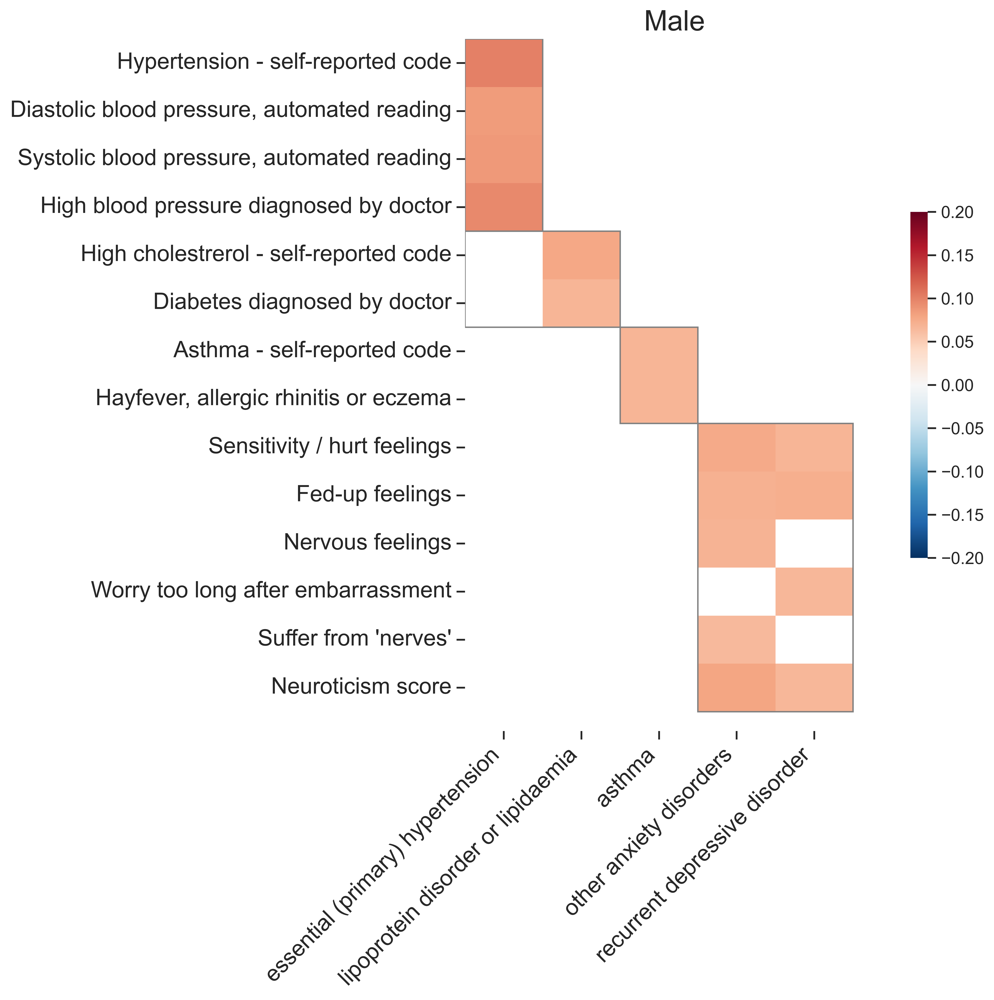

<Figure size 1600x1600 with 0 Axes>

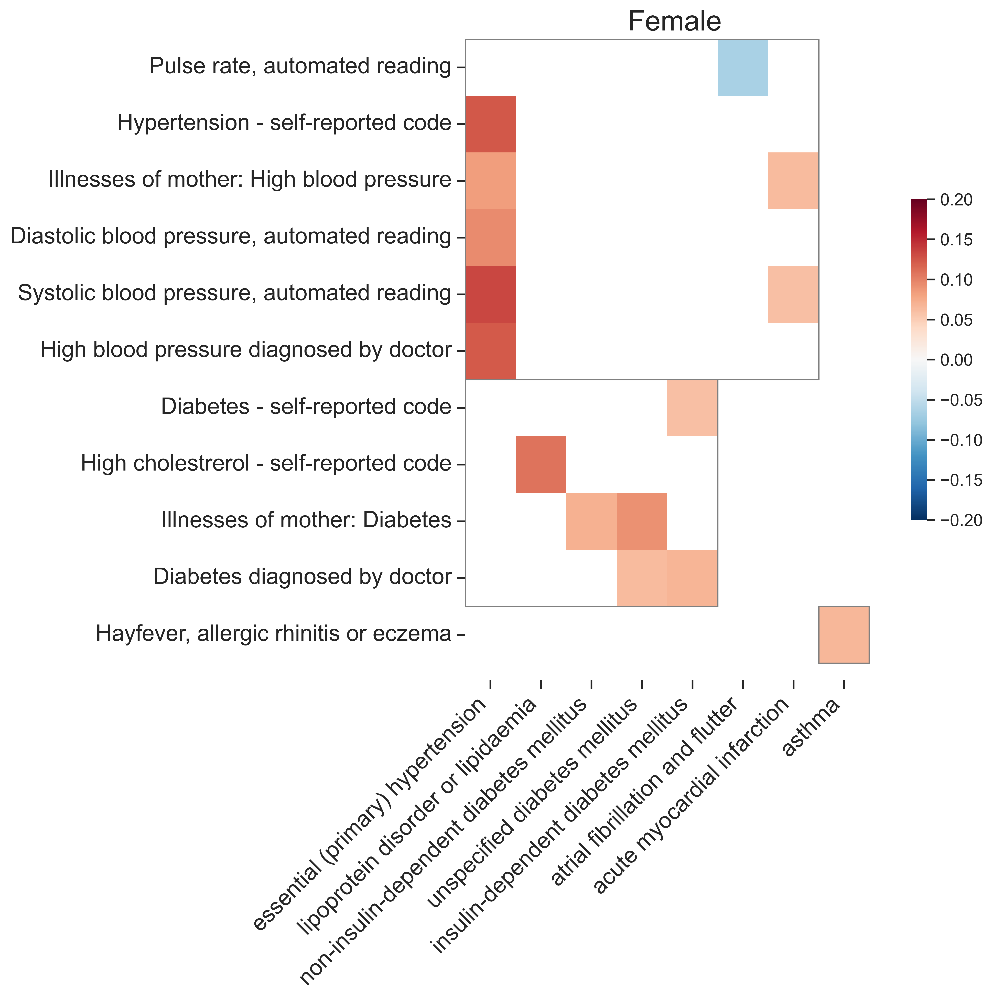

In [197]:
# run

prs_file = glob.glob(os.path.join(data_dir,'corrs','prs.csv'))
loader_dict = load_corrs_dict_gendered(prs_file)
loader_dict = fdr_correct_nested(loader_dict, alpha=0.05, method='bonferroni')
loader_dict = drop_nonsig_gendered_bh(loader_dict)
loader_dict = rename_reorder_prs(loader_dict)
stacked_dict = stack_loaders_dict(loader_dict)
plot_corrs_pvals_genders(stacked_dict["all"]['m_corrs'],stacked_dict["all"]['m_pvals_fdr'],"PRS","Male",borders=prs_groups)
plot_corrs_pvals_genders(stacked_dict["all"]['f_corrs'],stacked_dict["all"]['f_pvals_fdr'],"PRS","Female",borders=prs_groups)

#### Sex specific features

In [22]:
# Sex-specific analysis

files_list = glob.glob(os.path.join(data_dir,'corrs','*.csv'))
files_list = [f for f in files_list if '_salient' not in f] # remove salient feature files

loader_dict = load_corrs_dict_gendered(files_list)
loader_dict = {k:v for k,v in loader_dict.items() if k in loaders} # !!!
loader_dict = fdr_correct_nested(loader_dict, alpha=0.05, method='bonferroni')

for l in loader_dict:#['liver','diet',,'retina','cgm','microbiome','abi','carotid']:
    m, f = loader_dict[l]['m_corrs'], loader_dict[l]['f_corrs']
    mp, fp = loader_dict[l]['m_pvals_reject_fdr'], loader_dict[l]['f_pvals_reject_fdr']
    print(l)
#     row_inds,col_inds = (((abs(f)>0.05)&(abs(m)>2*abs(f))& mp.notnull()) | ((abs(m)>0.51)&(abs(f)>2*abs(m))& fp.notnull())).values.nonzero()
#     print((list(zip(m.index[row_inds], m.columns[col_inds]))))
 #   mrow_inds,mcol_inds = (((abs(m)>2*abs(f))& mp.notnull())).values.nonzero()
    mrow_inds,mcol_inds = (((abs(m)>0.1)&(abs(m)>2*abs(f))& mp)).values.nonzero()
    print((list(zip(m.index[mrow_inds], m.columns[mcol_inds]))))
    mrows = [m.index[i] for i in mrow_inds]
    mcols = [m.columns[i] for i in mcol_inds]
    mvals = [m.loc[r,c] for r,c in zip(mrows,mcols)]
    fvals = [f.loc[r,c] for r,c in zip(mrows,mcols)]
    loader_res_m = pd.DataFrame({"Feature":mrows,"Outcome":mcols,"mcorr":mvals,"fcorr":fvals})
    loader_res_m.to_csv(os.path.join(outdir,f'male_specific_{l}.csv'))
    
#    frow_inds,fcol_inds = (((abs(f)>2*abs(m))& fp.notnull())).values.nonzero()
    frow_inds,fcol_inds = (((abs(f)>0.1)&(abs(f)>2*abs(m))& fp)).values.nonzero()
    print((list(zip(f.index[frow_inds], f.columns[fcol_inds]))))
    frows = [f.index[i] for i in frow_inds]
    fcols = [f.columns[i] for i in fcol_inds]
    fvals = [f.loc[r,c] for r,c in zip(frows,fcols)]
    mvals = [m.loc[r,c] for r,c in zip(frows,fcols)]
    loader_res_f = pd.DataFrame({"Feature":frows,"Outcome":fcols,"mcorr":mvals,"fcorr":fvals})
    loader_res_f.to_csv(os.path.join(outdir,f'female_specific_{l}.csv'))
    
    print(f'{len(set([m.index[i] for i in mrow_inds] + [f.index[i] for i in frow_inds]))} features,\
    {len(set([m.columns[i] for i in mcol_inds]+[f.columns[i] for i in fcol_inds]))} diseases')

3692
153
153
436
434
6
518
18
16
99
112
111
48
72
71
48
47
88
(514650,) (514650,) (519500,)
Generated corrected p-values
metabolomics
[('Lipids_NEG_172.9911_36.9286_129.8889', 'chronic renal failure'), ('Lipids_NEG_188.9861_36.9286_129.5368', 'other non-toxic goitre'), ('Lipids_NEG_187.0069_37.7188_137.4008', 'chronic renal failure'), ('Lipids_NEG_215.0016_38.5303_139.8199', 'acute myocardial infarction'), ('Lipids_NEG_215.0016_38.5303_139.8199', 'atherosclerosis'), ('Lipids_NEG_215.0016_38.5303_139.8199', "parkinson's disease"), ('Lipids_NEG_213.0223_40.7096_148.0475', 'cholelithiasis'), ('Lipids_NEG_437.0547_40.8126_207.2894', 'acute pancreatitis'), ('Lipids_NEG_479.2833_127.1033_259.8385', 'other diseases of liver'), ('Lipids_NEG_479.2833_127.1033_259.8385', 'cholelithiasis'), ('Lipids_NEG_479.2833_127.1033_259.8385', 'acute pancreatitis'), ('Lipids_NEG_279.2324_158.6982_181.6171', 'other diseases of liver'), ('Lipids_NEG_279.2324_158.6982_181.6171', 'other inflammatory liver diseas

#### Examine specific correlations

In [9]:
# high corrs

files_list = glob.glob(os.path.join(data_dir,'corrs','*.csv'))
files_list = [f for f in files_list if '_salient' not in f] # remove salient feature files

loader_dict = load_corrs_dict_gendered(files_list)
loader_dict = {k:v for k,v in loader_dict.items() if k in loaders} # !!!
loader_dict = fdr_correct_nested(loader_dict, alpha=0.05, method='bonferroni')

for l in ['metabolomics']:# loader_dict #['liver','diet',,'retina','cgm','microbiome','abi','carotid']:
    m, f = loader_dict[l]['m_corrs'], loader_dict[l]['f_corrs']
    mp, fp = loader_dict[l]['m_pvals_reject_fdr'], loader_dict[l]['f_pvals_reject_fdr']
    print(l)
    row_inds,col_inds = (((abs(f)>0.25) & fp)|((abs(m)>0.25) & mp)).values.nonzero()
    print((list(zip(m.index[row_inds], m.columns[col_inds]))))
    rows = [m.index[i] for i in row_inds]
    cols = [m.columns[i] for i in col_inds]
    mvals = [m.loc[r,c] for r,c in zip(rows,cols)]
    fvals = [f.loc[r,c] for r,c in zip(rows,cols)]
    loader_res = pd.DataFrame({"Feature":rows,"Outcome":cols,"mcorr":mvals, "fcorr":fvals})
    loader_res = loader_res.sort_values(by='mcorr')
    print(loader_res.shape)
    print(f"Features: {loader_res['Feature'].nunique()}, Diseases: {loader_res['Outcome'].unique().tolist()}")
    print(loader_res.sort_values(by='Outcome').head(60))
    print(loader_res['Feature'].value_counts().head(20))

3692
153
153
436
434
6
518
18
16
99
112
111
48
72
71
48
47
88
(514650,) (514650,) (519500,)
metabolomics m_pvals (3692, 50)
metabolomics f_pvals (3692, 50)
diet m_pvals (153, 50)
diet f_pvals (153, 50)
DEXA m_pvals (434, 50)
DEXA f_pvals (434, 50)
carotid m_pvals (6, 50)
carotid f_pvals (6, 50)
microbiome m_pvals (518, 50)
microbiome f_pvals (518, 50)
ABI m_pvals (16, 50)
ABI f_pvals (16, 50)
liver m_pvals (99, 50)
liver f_pvals (99, 50)
ECG m_pvals (111, 50)
ECG f_pvals (111, 50)
retina m_pvals (48, 50)
retina f_pvals (48, 50)
sleep m_pvals (71, 50)
sleep f_pvals (71, 50)
CGM m_pvals (47, 50)
CGM f_pvals (47, 50)
TOTAL 519500
Generated corrected p-values
metabolomics
[('Lipids_NEG_564.3306_159.2347_246.9704', 'cholelithiasis'), ('Lipids_NEG_596.3921_227.4468_265.4222', 'unspecified diabetes mellitus'), ('Lipids_NEG_596.3921_227.4468_265.4222', 'acute pancreatitis'), ('Lipids_NEG_800.5807_343.7668_309.5199', 'cholelithiasis'), ('Lipids_NEG_800.5807_343.7668_309.5199', 'acute pancreatit

#### Modalities' explained variance


In [4]:
# Figure 4
# Functions

loader_name_dict = {'diet':'dietnew', 'ABI':'abi','DEXA':'dexa',
                    'CGM':'cgm','ECG':'ecg'}

def get_loader_lasso_outcomes_multi():
    ''' Returns the lasso outcomes for the loaders (including age, gender, bmi in each loader)
    '''
    loader_outcomes_dict = {}
    for o in outcomes_dict:
        loader_outcomes_dict[outcomes_dict[o]] = {}
        for loader in loaders[:-1]:
            loader_name = loader_name_dict.get(loader, loader)
            outcome_loader_ev_files = glob.glob(os.path.join(data_dir,'multivariate',f"{o}_ev_{loader_name}_*.csv"))
            for f in outcome_loader_ev_files:
                loader_name = f'{loader}_{f.strip().split("_")[-1][:-4]}' # add the number
                loader_eval = pd.read_csv(f)['r2'].values[0]
                loader_outcomes_dict[outcomes_dict[o]][loader_name] = loader_eval
    return  pd.DataFrame.from_dict(loader_outcomes_dict)#.reindex(loaders[:-1])


def get_loader_agb_lasso_outcomes_multi():
    ''' Returns the lasso outcomes for age, gender, bmi from the loaders
    '''
    loader_agb_outcomes_dict = {}
    for o in outcomes_dict:
        loader_agb_outcomes_dict[outcomes_dict[o]] = {}
        for loader in loaders[:-1]:
            loader_name = loader_name_dict.get(loader, loader)
            outcome_loader_ev_files = glob.glob(os.path.join(data_dir,'multivariate',f"{o}_baseline_ev_from_{loader_name}_*.csv"))
            for f in outcome_loader_ev_files:
                loader_name = f'{loader}_{f.strip().split("_")[-1][:-4]}' # add the number
                loader_eval = pd.read_csv(f)['r2'].values[0]
                loader_agb_outcomes_dict[outcomes_dict[o]][loader_name] = loader_eval
    return  pd.DataFrame.from_dict(loader_agb_outcomes_dict)


def summarize_resamples(loader_lasso_dict, loader_agb_dict):
    lasso_df = pd.DataFrame(index=loaders[:-1], columns = loader_lasso_dict.columns, dtype=np.float64 )
    agb_df = pd.DataFrame(index=loaders[:-1], columns = loader_agb_dict.columns, dtype=np.float64)
    pvals_df = pd.DataFrame(index=loaders[:-1], columns = loader_lasso_dict.columns, dtype=np.float64 )
    for loader in loaders[:-1]:
        loader_lasso = loader_lasso_dict.filter(like=loader,axis=0)
        loader_agb = loader_agb_dict.filter(like = loader,axis=0)
        print(loader)
        
        
        def get_top_100(series):
            return series.nlargest(100)

        # Apply the function to each column
        loader_lasso = loader_lasso.apply(get_top_100)
        loader_agb = loader_agb.apply(get_top_100)
        loader_lasso = loader_lasso
        loader_agb = loader_agb
        
        print(loader_lasso.notna().sum())
        print((loader_lasso<0).sum())

        
        stat, p_value = stats.wilcoxon(loader_lasso-loader_agb, nan_policy='omit', method='exact')
        pvals_df.loc[loader] = p_value
        print(stat,p_value)
        stat, p_value = stats.mannwhitneyu(loader_lasso,loader_agb,nan_policy='omit',method='exact')
        
            

        lasso_mean = loader_lasso.mean()
        agb_mean = loader_agb.mean()

        lasso_df.loc[loader] = lasso_mean
        agb_df.loc[loader] = agb_mean

        
    lasso_df[pvals_df>=(0.05/pvals_df.shape[0]*pvals_df.shape[1])] = np.nan   
        
    return lasso_df,agb_df  


def get_r2_deltas(loader_lasso_dict, loader_agb_dict):
    deltas = loader_lasso_dict-loader_agb_dict
    deltas.to_csv(os.path.join(outdir,'r2_deltas.csv'))
    return deltas

def get_agb_results_multi():
    agb_outcomes = {}
    for o in outcomes_dict:
        agb_files = glob.glob(os.path.join(data_dir,'multivariate',f"{o}_agb_age_gender_bmi_*.csv"))
        agb_outcomes[outcomes_dict[o]] = {}
        for f in agb_files:
            i = f.strip().split('_')[-1][:-4]
            r=pd.read_csv(f)['r2'].values[0]
            agb_outcomes[outcomes_dict[o]][i] = r
    return pd.DataFrame.from_dict(agb_outcomes)


def plot_r2_fig(r2_deltas, agb_r2s):
    
    agb_means = agb_r2s.mean()
    agb_ci = agb_r2s.quantile(q= [.025, .975])
    ci_lower = agb_means - agb_ci.loc[0.025]
    ci_upper = agb_ci.loc[0.975] - agb_means
    
    sorted_indices = agb_means.sort_values().index
    agb_means = agb_means[sorted_indices]
    r2_deltas = r2_deltas[sorted_indices]
    
    fig, ax = plt.subplots(nrows=2, ncols=2, figsize=(12, 10), sharex='col',
                                                      gridspec_kw={'height_ratios': [1, 3.5], 'width_ratios': [20, 1]},dpi=300)
    ax[0,1].remove()    
    cmap=sns.color_palette('RdBu_r',n_colors=256)
    sns.heatmap(r2_deltas, ax=ax[1,0], cbar_ax = ax[1,1],cmap = cmap, center=0, square=False)
    
    num_cols = len(r2_deltas.columns)
    ax[1,0].set_xticks(np.arange(num_cols) + 0.5)
    ax[1,0].set_xticklabels([ukb_disease_short_names_dict.get(x,x,) for x in r2_deltas.columns])#, ha='center')
    
    # Plot the barplot
    x = np.arange(len(agb_means))
    width = 0.8  # the width of the bars
    ax_bar = ax[0, 0]
    ax_bar.bar(x+0.5, agb_means, width, yerr=[ci_lower, ci_upper], align='center', color = sns.color_palette("husl", len(agb_means)))

    ax[0,0].set_ylabel("Age, sex, bmi")
    ax[0, 0].yaxis.set_label_coords(-0.05, 0.5)
    ax[1,0].tick_params(axis='x', length=0)
    ax[0,0].tick_params(axis='x', length=0)
    plt.tight_layout()
    plt.savefig(os.path.join(outdir,'r2_deltas_CI.pdf'))  
            

retina
essential (primary) hypertension                             100
acute myocardial infarction                                  100
chronic ischaemic heart disease                              100
unspecified diabetes mellitus                                100
asthma                                                       100
other diseases of liver                                      100
other inflammatory liver diseases                            100
fibrosis and cirrhosis of liver                              100
obesity                                                      100
insulin-dependent diabetes mellitus                          100
non-insulin-dependent diabetes mellitus                      100
other acute ischaemic heart diseases                         100
nonrheumatic aortic valve disorders                          100
nonrheumatic mitral valve disorders                          100
cardiomyopathy                                               100
heart failure     

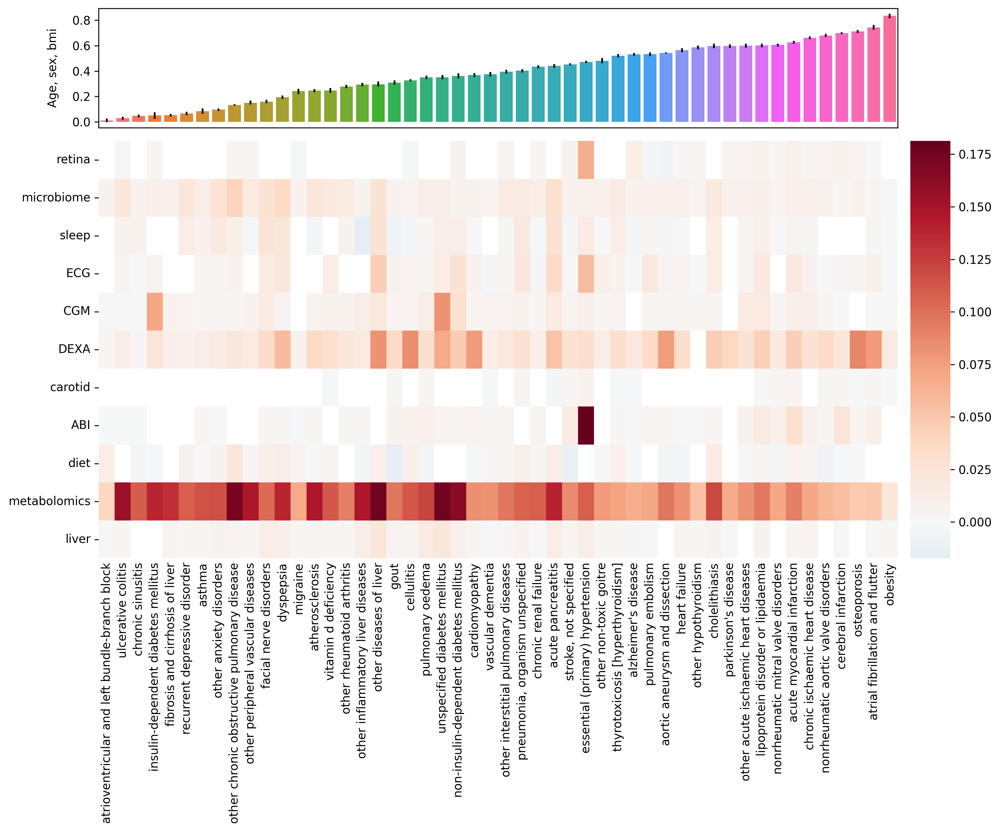

In [5]:
# Run
loader_lasso_outcomes = get_loader_lasso_outcomes_multi()
loader_agb_outcomes = get_loader_agb_lasso_outcomes_multi()
lasso_outcomes, agb_outcomes = summarize_resamples(loader_lasso_outcomes, loader_agb_outcomes)

print(lasso_outcomes)
print(agb_outcomes)

lasso_outcomes.to_csv(os.path.join(outdir,'lasso_outcomes.csv'))
agb_outcomes.to_csv(os.path.join(outdir,'agb_outcomes.csv'))

r2_deltas = get_r2_deltas(lasso_outcomes,agb_outcomes)
agb_r2s = get_agb_results_multi()

plot_r2_fig(r2_deltas, agb_r2s)

#### trajectories

In [52]:
from scipy.stats import norm


renal_df = load_outcome(outcomes_inv_dict['chronic renal failure'])
renal_df = renal_df/-365.25 # convert to years
hba1c_df = load_outcome(outcomes_inv_dict['non-insulin-dependent diabetes mellitus'])
hba1c_df = hba1c_df/-365.25 # convert to years
egfr_deltas = pd.read_csv(os.path.join(data_dir,'deltas','egfr_changes.csv'),index_col=0)
egfr_deltas = egfr_deltas[(egfr_deltas['interval_years']>2) & (egfr_deltas['interval_years']<10)]
hba1c_deltas = pd.read_csv(os.path.join(data_dir,'deltas','hba1c_changes.csv'),index_col=0)
hba1c_deltas = hba1c_deltas[(hba1c_deltas['interval_years']>2) & (hba1c_deltas['interval_years']<10)]


merged_hba1c = hba1c_deltas.join(hba1c_df).dropna()
merged_hba1c['predm'] = ((merged_hba1c['baseline'] < 5.7)&(merged_hba1c['end']>=5.7)).astype(int)
m_merged_hba1c = merged_hba1c[merged_hba1c['gender']==1].drop(columns='gender')
f_merged_hba1c = merged_hba1c[merged_hba1c['gender']==0].drop(columns='gender')
m_merged_hba1c = sm.add_constant(m_merged_hba1c)
f_merged_hba1c = sm.add_constant(f_merged_hba1c)

m_hba1c_model = sm.Logit(m_merged_hba1c['predm'], m_merged_hba1c[['predictions','age','bmi','baseline']]).fit(disp=0)
f_hba1c_model = sm.Logit(f_merged_hba1c['predm'], f_merged_hba1c[['predictions','age','bmi','baseline']]).fit(disp=0)

merged_egfr = egfr_deltas.join(renal_df).dropna()
merged_egfr['predm'] = ((merged_egfr['baseline'] >=90)&(merged_egfr['end']<90)).astype(int)
m_merged_egfr = merged_egfr[merged_egfr['gender']==1].drop(columns='gender')
f_merged_egfr = merged_egfr[merged_egfr['gender']==0].drop(columns='gender')
m_merged_egfr = sm.add_constant(m_merged_egfr)
f_merged_egfr = sm.add_constant(f_merged_egfr)

m_egfr_model = sm.Logit(m_merged_egfr['predm'], m_merged_egfr[['predictions','age','bmi','baseline']]).fit(disp=0)
f_egfr_model = sm.Logit(f_merged_egfr['predm'], f_merged_egfr[['predictions','age','bmi','baseline']]).fit(disp=0)


alpha = 0.05
z_bonf = norm.ppf(1 - alpha / (2 * 4)) # 4 tests total

m_dict = {"Condition" : ['Onset of pre-diabetes', 'Onset of stage 2 CKD'],
          "Pseudo-outcome" : ['non-insulin-dependent diabetes mellitus', 'chronic renal failure'],
          "OR" : [np.exp(m_hba1c_model.params['predictions']), np.exp(m_egfr_model.params['predictions'])],
          "p-vals" : [m_hba1c_model.pvalues['predictions']*4, m_egfr_model.pvalues['predictions']*4],
          "ci_lower" : [np.exp(m_hba1c_model.params['predictions'] - z_bonf * m_hba1c_model.bse['predictions']),
                            np.exp(m_egfr_model.params['predictions'] - z_bonf * m_egfr_model.bse['predictions'])],
          "ci_upper" : [np.exp(m_hba1c_model.params['predictions'] + z_bonf * m_hba1c_model.bse['predictions']),  
                            np.exp(m_egfr_model.params['predictions'] + z_bonf * m_egfr_model.bse['predictions'])]}

f_dict = {"Condition" : ['Onset of pre-diabetes', 'Onset of stage 2 CKD'],
            "Pseudo-outcome" : ['non-insulin-dependent diabetes mellitus', 'chronic renal failure'],
            "OR" : [np.exp(f_hba1c_model.params['predictions']), np.exp(f_egfr_model.params['predictions'])],
            "p-vals" : [f_hba1c_model.pvalues['predictions']*4, f_egfr_model.pvalues['predictions']*4],
            "ci_lower" : [np.exp(f_hba1c_model.params['predictions'] - z_bonf * f_hba1c_model.bse['predictions']),
                                np.exp(f_egfr_model.params['predictions'] - z_bonf * f_egfr_model.bse['predictions'])],
            "ci_upper" : [np.exp(f_hba1c_model.params['predictions'] + z_bonf * f_hba1c_model.bse['predictions']),  
                                np.exp(f_egfr_model.params['predictions'] + z_bonf * f_egfr_model.bse['predictions'])]}

m_df = pd.DataFrame(m_dict)
f_df = pd.DataFrame(f_dict)

def plot_ors(df,prefix=None):
    
    sorted_df = df.sort_values(by="ci_lower",ascending=True)
    plt.clf()
    
    fig, ax1 = plt.subplots(figsize=(9,2))
    ax2 = ax1.twinx()
    ax1.set_xlabel('Odds ratio', fontsize=16)

    ax1.axvline(x=1, color='black', linestyle='--', linewidth=1)

    sns.scatterplot(data=sorted_df,y="Condition",x="OR", s=80, ax=ax1)#,hue="sig",palette={True:"slategray",False:"lightgray"})
    ax1.errorbar(
        sorted_df["OR"],
        range(len(sorted_df)),
        xerr=[
            sorted_df["OR"] - sorted_df["ci_lower"],
            sorted_df["ci_upper"] - sorted_df["OR"]
        ],
        fmt='none',
        color='black',
        capsize=3,
        elinewidth=1
    )

    ax1.set(ylabel=None)
    ax2.set(ylabel=None)
    ax1.tick_params(axis='y', labelsize=12)
    ax1.tick_params(axis='x', labelsize=12)
    ax2.tick_params(axis='y', labelsize=12)

    ax2.set_yticks(range(len(sorted_df)))
    ax2.set_yticklabels(sorted_df['Pseudo-outcome'])
    ax1.set_yticks(range(len(sorted_df)))
    ax1.set_xticks(np.arange(1, 1.24, 0.1))
    ax1.set_yticklabels(sorted_df['Condition'])
    
    ax1.set_ylim(-0.5, len(sorted_df) - 0.5)
    ax2.set_ylim(-0.5, len(sorted_df) - 0.5)
    
    

    ax1.annotate(
        'Condition',
        xy=(-0.1, 1.01),
        xycoords='axes fraction',
        ha='right',
        fontsize=14,
    )
    
    ax2.annotate(
        'Pseudo-outcome',
        xy=(1.1, 1.01),
        xycoords='axes fraction',
        ha='left',
        fontsize=14,
    )
    
    if prefix is not None:
        ax1.set_title(prefix,fontsize=16)

    plt.tight_layout()
    
    fname = "progression_ors.png"
    if prefix is not None:
        fname = f"progression_ors_{prefix}.png"
    plt.savefig(os.path.join(outdir,fname),dpi=300)
    plt.clf()
    
plot_ors(m_df,'Male')
plot_ors(f_df,"Female")

print(m_df)

print(f_df)

Loaded predictions for 132032
Loaded predictions for 130708


<Figure size 640x480 with 0 Axes>

<Figure size 900x200 with 0 Axes>

<Figure size 900x200 with 0 Axes>

(9077, 4)
Loaded predictions for 131286
Loaded predictions for 131380
Loaded predictions for 131350
Loaded predictions for 131338
Loaded predictions for 131306
Loaded predictions for 131354
Loaded predictions for 131304
Loaded predictions for 131298
Loaded predictions for 131368
Loaded predictions for 131366
                                          Male  pad    Female
essential (primary) hypertension      0.707774  NaN  0.718733
atherosclerosis                       0.616133  NaN  0.625324
atrial fibrillation and flutter       0.757353  NaN  0.810603
cardiomyopathy                        0.505447  NaN  0.516347
chronic ischaemic heart disease       0.737134  NaN  0.752945
heart failure                         0.740608  NaN  0.792376
other acute ischaemic heart diseases  0.732438  NaN  0.744460
acute myocardial infarction           0.821084  NaN  0.833607
stroke, not specified                 0.726791  NaN  0.757069
cerebral infarction                   0.866576  NaN  0.903175


<Figure size 640x480 with 0 Axes>

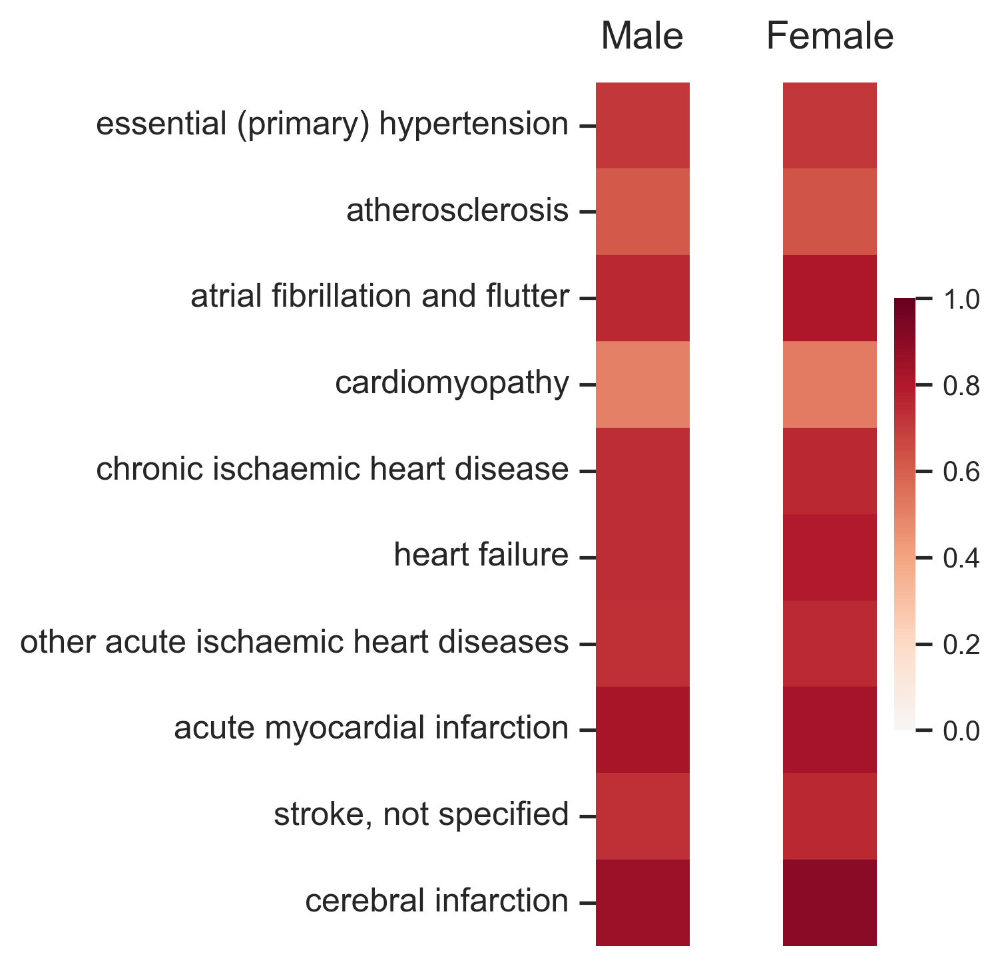

In [73]:
### Score2 correlations
from pingouin import partial_corr, pairwise_corr

score2 = pd.read_csv(os.path.join(data_dir,'deltas','score2.csv'),index_col=0)

outcome_list = ["essential (primary) hypertension", "atherosclerosis", "atrial fibrillation and flutter", "cardiomyopathy",
                "chronic ischaemic heart disease", "heart failure", "other acute ischaemic heart diseases", 
                "acute myocardial infarction", "stroke, not specified", "cerebral infarction"]


print(score2.shape)
for o in outcome_list:
    df = load_outcome(outcomes_inv_dict[o])/-365.25
    df = df.rename(columns={'predictions':o})
    score2 = score2.join(df, how='inner')


m_merged = score2[score2['gender']==1].drop(columns = ['age','gender','bmi'])
f_merged = score2[score2['gender']==0].drop(columns = ['age','gender','bmi'])

res_df = pd.DataFrame(columns=['Male', 'pad', 'Female'], index=outcome_list)
res_df['Male'] = m_merged.corr(method='spearman').loc['Score',outcome_list]
res_df['pad'] = np.nan
res_df['Female'] = f_merged.corr(method='spearman').loc['Score',outcome_list]

print(res_df)

cmap=sns.color_palette('RdBu_r',n_colors=256)
plt.clf()
fig, ax = plt.subplots(figsize=(5, 5),dpi=300)
heatmap = sns.heatmap(res_df,cmap=cmap,center=0,cbar_kws={"shrink":0.5},vmin=0,vmax=1)##,dendrogram_ratio=(0.0,0.0))
colorbar = heatmap.collections[0].colorbar
colorbar.ax.tick_params(labelsize=10) 
plt.yticks(fontsize=12)
ax.xaxis.set_ticks_position('none')  # remove tick marks entirely
ax.tick_params(top=False, labeltop=True, bottom=False, labelbottom=False)
ax.set_xticklabels(['Male','','Female'], fontsize=14)
plt.tight_layout()
plt.savefig(os.path.join(outdir,f'score_corrs.png'))   









In [16]:
df = pd.read_csv(os.path.join(data_dir,'smoking','smoking_microbiome_association.csv'),index_col=0)
df[['smokers_mean','nonsmokers_mean']] = df[['smokers_mean','nonsmokers_mean']].round(3)
df['adjusted_p_value'] = df['adjusted_p_value'].apply(lambda x: f"{x:.3e}")
df.to_csv(os.path.join(outdir,'smoking_microbiome_association.csv'))